In [48]:
import matplotlib.pyplot as plt
import math
import numpy as np
from astropy.io import fits
from astropy.visualization import astropy_mpl_style
plt.style.use(astropy_mpl_style)
import os
from glob import glob
import warnings
warnings.filterwarnings("ignore")
# warnings.filterwarnings("default")
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import make_axes_locatable
plt.rc('font', size=20)          # controls default text sizes
plt.rc('axes', titlesize=20)     # fontsize of the axes title
plt.rc('axes', labelsize=20)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=20)    # fontsize of the tick labels
plt.rc('ytick', labelsize=20)    # fontsize of the tick labels
plt.rc('legend', fontsize=20)    # legend fontsize
plt.rc('figure', titlesize=24)  # fontsize of the figure title

%matplotlib inline

# Centalt and Secant Calculation

In [49]:
def printCENTALT(directory):
    files = sorted(glob(directory))
    print(len(files))
    for i, filename in enumerate(files):
        try:
            # print('s')
            hdul = fits.open(filename)

            cent=hdul[0].header['CENTALT']
            # print(f'{cent}')
            # rdnoise=hdul[0].header['RDNOISE']
            rdnoise='d'
            sec = 1/(np.cos(cent*(np.pi/180)))
            # sec='d'
            
            print(f'{i:02d}: {filename[127:]}, \t\t{cent}, \t\t{rdnoise}, \t\t{sec}')
            
            if (i+1) % 8 == 0:
                print('-'*80)
            elif (i+1) % 4 == 0:
                print('-'*40)
        except:
            print(end='\r')

# printCENTALT('PersonalCode/data4')
# printCENTALT('/Users/anthonylabarca/Library/CloudStorage/OneDrive-UniversityofRochester/Classes/Senior_Year/Spring/ASTR244/seyfert/data/NGC4051 3019_326/*')

## Real Functions

In [77]:
# Real functions that work 
def loadImageData(filename, vbounds = None, graph=True, title = None, save=False, dn = True, savename=None):
    if title is None: title = filename
    print(f"Loading {filename}")
    image_data = fits.getdata(filename)
    
    if graph:
        plt.figure(figsize=(8,8))
        if vbounds is not None: plt.imshow(np.log10(image_data), cmap='gray', vmin = vbounds[0], vmax = vbounds[1])
        else: plt.imshow(np.log10(image_data), cmap='gray')
        print('MEAN', np.nanmean(np.log10(image_data)))
        plt.colorbar()
        if dn:
            plt.ylabel('DN', fontsize = 20)
        else:
            plt.ylabel(r'Flux [log(ergs/s/cm$^2$)]', fontsize = 20)
            
        # plt.grid()
        plt.title(f'{title}')
        if save:
            if savename is not None: plt.savefig(f'images/{savename}.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
            elif title is not None: plt.savefig(f'images/{title}.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
            else: plt.savefig(f'images/poop.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)

    
    return image_data
    
def distanceFinder(point, center):
    return np.sqrt((center[0]-point[0])**2+(center[1]-point[1])**2)

def plotGalaxy(image, aproxCent = None, vbounds = None, graph = True, radius = 600, title = 'approximate zoom-in', save = False, dn=True, savename=None):
    image_approximate = image[2200:3200, 1400:2500]
    if aproxCent is not None: 
        xmin, xmax = aproxCent[0]-radius, aproxCent[0]+radius
        ymin, ymax = aproxCent[1]-radius, aproxCent[1]+radius
        image_approximate = image[xmin:xmax, ymin:ymax]
    # center = np.where(image == np.amax(image[-2000:]))
    # print(center)
    # plt.scatter(center[0], center[1], color='yellow')
    # center=(1000,1000)
    # image_smaller = image[int(center[0]):int(center[0])+528, int(center[1])-528:int(center[1])+528]
    if graph:
        plt.figure(figsize=(8,8))
        if vbounds is not None: 
            print("inbounds")
            plt.imshow(np.log10(image_approximate), cmap='gray', vmin 
                       = vbounds[0], vmax = vbounds[1])
        else: plt.imshow(np.log10(image_approximate), cmap='gray')
        
        plt.colorbar()
        plt.title(title)
        plt.scatter(radius, radius, color='red', marker="+")
        if save:
            if savename is not None: plt.savefig(f'images/{savename}.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
            elif title is not None: plt.savefig(f'images/{title}.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
            else: plt.savefig(f'images/poop.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)

            

            
            
def graph_indep(image, aproxCent = None, vbounds = None, graph = True, radius = 600, savename='boop', title = 'approximate zoom-in', save = False, dn=True):
    image_approximate = image[2200:3200, 1400:2500]
    if aproxCent is not None: 
        xmin, xmax = aproxCent[0]-radius, aproxCent[0]+radius
        ymin, ymax = aproxCent[1]-radius, aproxCent[1]+radius
        image_approximate = image[xmin:xmax, ymin:ymax]
    # center = np.where(image == np.amax(image[-2000:]))
    # print(center)
    # plt.scatter(center[0], center[1], color='yellow')
    # center=(1000,1000)
    # image_smaller = image[int(center[0]):int(center[0])+528, int(center[1])-528:int(center[1])+528]
    if graph:
        fig, ax = plt.subplots(figsize=(8,8))
        divider = make_axes_locatable(ax)
        cax = divider.append_axes('right', size='5%', pad=0.1)
        if vbounds is not None: 
            print("inbounds")
            im = ax.imshow(np.log10(image_approximate), cmap='gray', vmin = vbounds[0], vmax = vbounds[1])
        else: im = ax.imshow(np.log10(image_approximate), cmap='gray')
        fig.colorbar(im, cax=cax, orientation='vertical')
        ax.tick_params(axis = "both", left=False, right = False, top = False, bottom = False, labelleft = False, labelbottom = False)
        cax.tick_params(labelsize = 20)
        if dn:
            cax.set_ylabel('DN', fontsize = 20)
        else:
            cax.set_ylabel(r'Flux [log(ergs/s/cm$^2$)]', fontsize = 20)
            
        ax.set_title(title)
        ax.scatter(radius, radius, color='red', marker="+")
        
        fig.tight_layout()
        if save:
            if savename is not None: plt.savefig(f'images/{savename}.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
            elif title is not None: plt.savefig(f'images/{title}.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
            else: plt.savefig(f'images/poop.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)

            
            
            
            

def graph1Dplot(data, axis, title=None, galaxy=None, dn = True, color = 'b'):
    if axis is None: fig, axis = plt.subplots(1,1, figsize = (20,10), sharey=True)
    axis.scatter(data[0], data[1], color = color, label = galaxy, alpha = .5)
    if len(axis.get_legend_handles_labels()[0]) is not 0:
        axis.legend()

    if title is not None: axis.set_title(title)
    axis.set_xlabel("Distance from brightest point (pixels)")
    if dn:
        axis.set_ylabel("Intensity (DN)")
    else:
        axis.set_ylabel(r"Flux [log(ergs/s/cm$^2$)]")
    axis.grid(False)

def graph1DSeperate(graphcolor, ax=None, **graphdata):
    if ax is None: fig, ax = plt.subplots(1,1, figsize = (10,5), sharey=True, dn = True)

        
    for name, data in graphdata.items():
        ax.scatter(data[0], data[1], label = f'NGC {name[-4:]}', alpha = .5)
            
    if len(ax.get_legend_handles_labels()[0]) is not 0:
        ax.legend()
    ax.set_title(f"Comparison of {graphcolor} Magnitudes as a function of distance")
    ax.set_xlabel("Distance from brightest point (pixels)")
    if dn:
        axis.set_ylabel("Intensity (DN)")
    else:
        axis.set_ylabel("Flux [log(ergs/s/cm$^2$)]")
    ax.grid(False)
    

def graphMaker(image, aproxCent, approxHa=None, vbounds = None, 
               radius_gal = 600, radius_core = 50, radius_clust = 40,
               graph = True, save = False, savename = "poop",
               title = "Approximate Galaxy Zoom-In", dn = True, color = 'b'
              ):
    if approxHa is None: approxTarget, radius_target = aproxCent, radius_core
    else: approxTarget, radius_target = approxHa, radius_clust
     #Crop image down to galaxy size
    xmin, xmax = aproxCent[0]-radius_gal, aproxCent[0]+radius_gal
    ymin, ymax = aproxCent[1]-radius_gal, aproxCent[1]+radius_gal

    image_cropped = image[xmin:xmax, ymin:ymax]
    minval = np.amin(np.log10(image_cropped))
    maxval = np.amax(np.log10(image_cropped))

    if vbounds is not None: minval, maxval = vbounds
    xmin_target, xmax_target = aproxCent[0]-radius_target, aproxCent[0]+radius_target
    ymin_target, ymax_target = aproxCent[1]-radius_target, aproxCent[1]+radius_target
    image_target_cropped = image[xmin_target:xmax_target, ymin_target:ymax_target]
    target_image = image_target_cropped

    minval_target = np.amin(np.log10(target_image))
    maxval_target = np.amax(np.log10(target_image))
    print(minval_target, maxval_target)


    # Now that we have the general idea of where the center is, the max value in the array can be used as the absolute center
    center = np.where(target_image == np.amax(target_image))
    cool_distance = np.array([])
    cool_brightness = np.array([])
    # fig, ax = plt.subplots()
    for i,v in enumerate(target_image):
        for j,u in enumerate(v):
            cool_distance = np.append(cool_distance, distanceFinder(center, (i,j)))
            # print(cool_distance)
            cool_brightness = np.append(cool_brightness, u)
            # cool = [distanceFinder(center, (i,j)), u]
        print(f'{i} finished out of {len(target_image)}', end='\r')
    # print(len(cool_distance), len(cool_brightness))
            # print(f'{cool} given the coordinates were ({i},{j})')
    result = np.array([cool_distance, cool_brightness])
    if graph: 
        fig = plt.figure(figsize=(10,8))
        gs = gridspec.GridSpec(2, 2)
        ax_gal = fig.add_subplot(gs[0,0])
        ax_zoom = fig.add_subplot(gs[0,1])
        ax_graph = fig.add_subplot(gs[1,:])
        
        ax_gal.imshow(np.log10(image_cropped), cmap='gray', vmin=minval, vmax=maxval)
        
        ax_gal.scatter(radius_gal, radius_gal, color='red', marker="+")
        # ax_gal.scatter(approxHa[0], approxHa[1], color='green', marker = '.')
        ax_zoom.imshow(np.log10(target_image), cmap='gray', vmin=minval_target, vmax=maxval_target)
        ax_zoom.scatter(center[1], center[0], color='green', marker='o')
        
        graph1Dplot(result, ax_graph, dn=dn, color=color)

        fig.suptitle(title)
        fig.tight_layout()
        if save:
            if savename is not None: plt.savefig(f'images/{savename}.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
            elif title is not None: plt.savefig(f'images/{title}.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
            else: plt.savefig(f'images/poop.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
 
    return result




## Testing

In [73]:
# # Find Center of Galaxies
# path_L_4051 = 'data/Mean NGC4051 L.FIT'
# path_L_3310 = 'data/Mean NGC3310 L.FIT'


# # tuple([10*x for x in img.size])
# approximateCenter_4051_1x1 = (2750, 1935)
# approximateCenter_4051 = tuple([x//2 for x in approximateCenter_4051_1x1])
# print(approximateCenter_4051, approximateCenter_4051_1x1)
# data_L_4051 = loadImageData(path_L_4051,(1.71,1.8), graph = False, title='NGC 3310 -- L', save=False)
# plotGalaxy(data_L_4051, approximateCenter_4051_1x1, (1.71,1.8), graph = False, title='NGC 4051 -- L', save=False)
# L_4051 = graphMaker(data_L_4051, approximateCenter_4051_1x1, vbounds=(1.71,1.8), graph = True, title='NGC 4051 -- L', save=False)


# approximateCenter_3310_1x1 = (2068, 2424)
# approximateCenter_3310 = tuple([x//2 for x in approximateCenter_3310_1x1])
# print(approximateCenter_3310, approximateCenter_3310_1x1)
# approxbound_3310 = (1.82,2.25)
# data_L_3310 = loadImageData(path_L_3310,approxbound_3310, graph = False, title='NGC 3310 -- L', save=False)
# plotGalaxy(data_L_3310, approximateCenter_3310_1x1, approxbound_3310, radius = 200, graph = False, title='NGC 3310 -- L', save=False)
# L_3310 = graphMaker(data_L_3310, approximateCenter_3310_1x1, vbounds=approxbound_3310, radius_gal = 200, radius_core = 50, graph = True, title='NGC 4051 -- L', save=False)

In [63]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.widgets import RangeSlider

%matplotlib inline


# In[14]:


# generate a fake image
def fixScaling(originalimage):
    img = np.log10(originalimage)

    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    fig.subplots_adjust(bottom=0.25)

    im = axs[0].imshow(img,cmap='gray' )
    axs[1].hist(img.flatten(), bins='auto')
    axs[1].set_title('Histogram of pixel intensities')

    # Create the RangeSlider
    slider_ax = fig.add_axes([0.20, 0.1, 0.60, 0.03])
    slider = RangeSlider(slider_ax, "Threshold", np.nanmin(img), np.nanmax(img))

    # Create the Vertical lines on the histogram
    lower_limit_line = axs[1].axvline(slider.val[0], color='k')
    upper_limit_line = axs[1].axvline(slider.val[1], color='k')


    def update(val):
        # The val passed to a callback by the RangeSlider will
        # be a tuple of (min, max)

        # Update the image's colormap
        im.norm.vmin = val[0]
        im.norm.vmax = val[1]

        # Update the position of the vertical lines
        lower_limit_line.set_xdata([val[0], val[0]])
        upper_limit_line.set_xdata([val[1], val[1]])

        # Redraw the figure to ensure it updates
        fig.canvas.draw_idle()


    slider.on_changed(update)
    plt.show()

## Import all Data

Loading data/5.7.23_7am_oldimages/Mean NGC4051 LongR.FIT
MEAN 2.975256
Loading data/5.7.23_7am_oldimages/Mean NGC4051 LongG.FIT
Loading data/5.7.23_7am_oldimages/Mean NGC4051 LongB.FIT
Loading data/5.7.23_3am/Mean NGC4051 halpha.FIT
Loading data/5.7.23_3am/Mean NGC4051 sii.FIT
Loading data/5.7.23_3am/Mean NGC4051 oiii.FIT


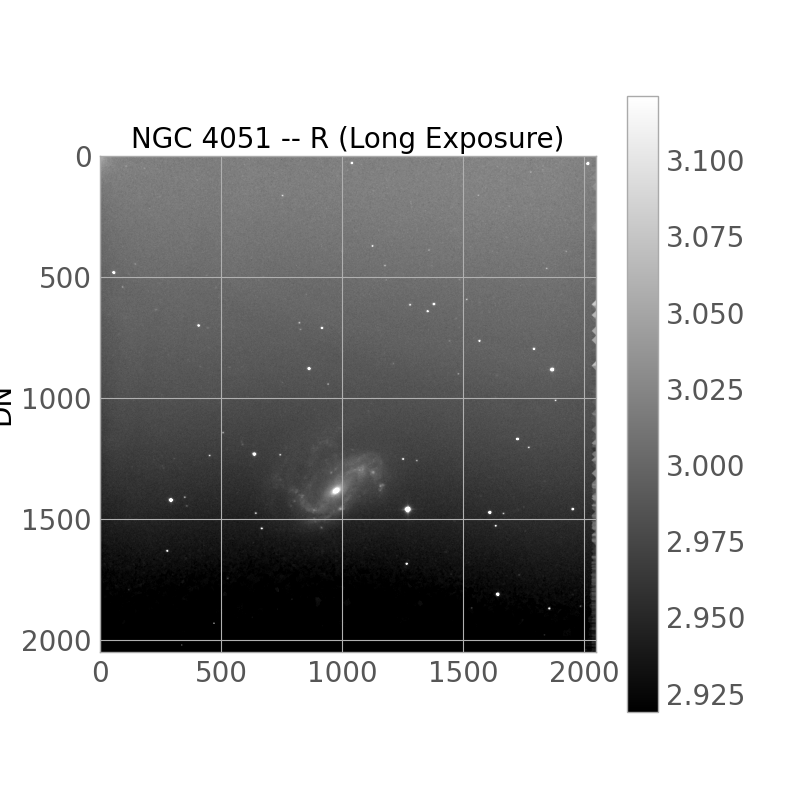

In [64]:
# NGC 4051
path_blue_4051 = 'data/5.7.23_7am_oldimages/Mean NGC4051 LongB.FIT'
path_red_4051 = 'data/5.7.23_7am_oldimages/Mean NGC4051 LongR.FIT'
path_green_4051 = 'data/5.7.23_7am_oldimages/Mean NGC4051 LongG.FIT'
path_ha_4051 = 'data/5.7.23_3am/Mean NGC4051 halpha.FIT'
path_s2_4051 = 'data/5.7.23_3am/Mean NGC4051 sii.FIT'
path_o3_4051 = 'data/5.7.23_3am/Mean NGC4051 oiii.FIT'

ha_4051_scaling = (2.542, 2.620)
o3_4051_scaling = (2.546, 2.585)
s2_4051_scaling = (2.391, 2.437)
scaling_sh_4051 = (-.214, -.152)
scaling_oh_4051 = (-.100, -0.002)
g_4051_scaling = (2.814, 2.992)
b_4051_scaling = (2.871, 3.030)
r_4051_scaling = (2.919, 3.121)



approximateCenter_4051 = (1380, 972)

data_red_4051 = loadImageData(path_red_4051,
                              vbounds=r_4051_scaling,
                              graph = True, 
                              title='NGC 4051 -- R (Long Exposure)',
                              savename='4051R_Long',
                              save=True)
data_green_4051 = loadImageData(path_green_4051, 
                                vbounds=g_4051_scaling,
                                graph = True, 
                                title='NGC 4051 -- G (Long Exposure)',
                                savename='4051G_Long',
                                save=True)
data_blue_4051 = loadImageData(path_blue_4051, 
                               vbounds=b_4051_scaling,
                               graph = True, 
                               title='NGC 4051 -- B (Long Exposure)',
                               savename='4051B_Long',
                               save=True)
data_Ha_4051 = loadImageData(path_ha_4051, 
                             vbounds=ha_4051_scaling, 
                             graph = True, 
                             title=r'NGC 4051 -- H$\alpha$',
                             savename='4051Ha',
                             save=True)
data_S2_4051 = loadImageData(path_s2_4051,
                             vbounds=s2_4051_scaling,
                             graph = True, 
                             title='NGC 4051 -- [SII]',
                             savename='4051SII',
                             save=True)
data_O3_4051 = loadImageData(path_o3_4051,
                             vbounds=o3_4051_scaling,
                             graph = True, 
                             title='NGC 4051 -- [OIII]',
                             savename='4051OIII',
                             save=True)



In [22]:
# NGC 3310
path_blue_3310 = 'data/Mean NGC3310 blue.FIT'
path_red_3310 = 'data/Mean NGC3310 red.FIT'
path_green_3310 = 'data/Mean NGC3310 green.FIT'
path_ha_3310 = 'data/5.7.23_3am/Mean NGC3310 halpha.FIT'
path_s2_3310 = 'data/5.7.23_3am/Mean NGC3310 sii.FIT'
path_o3_3310 = 'data/5.7.23_3am/Mean NGC3310 oiii.FIT'


ha_3310_scaling = (1.956, 2.435)
o3_3310_scaling = (2.261, 2.485)
s2_3310_scaling = (1.929, 2.447)
scaling_sh_3310 = (-0.025, 0.092)
scaling_oh_3310 = (-0.0119, 0.2870)


g_3310_scaling = (1.955, 2.284)
b_3310_scaling =  (1.972, 2.228)
r_3310_scaling =  (2.538, 3.541)



                                
                               
                             
                             
                             

approximateCenter_3310 = (1032, 1212)

data_red_3310 = loadImageData(path_red_3310,
                              vbounds=r_3310_scaling,
                              graph = True, 
                              title='NGC 3310 -- R (Long Exposure)',
                              savename='3310R_Long',
                              save=True)
data_green_3310 = loadImageData(path_green_3310, 
                                vbounds=g_3310_scaling,
                                graph = True, 
                                title='NGC 3310 -- G (Long Exposure)',
                                savename='3310G_Long',
                                save=True)
data_blue_3310 = loadImageData(path_blue_3310, 
                               vbounds=b_3310_scaling,
                               graph = True, 
                               title='NGC 3310 -- B (Long Exposure)',
                               savename='3310B_Long',
                               save=True)
data_Ha_3310 = loadImageData(path_ha_3310, 
                             vbounds=ha_3310_scaling, 
                             graph = True, 
                             title=r'NGC 3310 -- H$\alpha$',
                             savename='3310Ha',
                             save=True)
data_S2_3310 = loadImageData(path_s2_3310,
                             vbounds=s2_3310_scaling,
                             graph = True, 
                             title='NGC 3310 -- [SII]',
                             savename='3310SII',
                             save=True)
data_O3_3310 = loadImageData(path_o3_3310,
                             vbounds=o3_3310_scaling,
                             graph = True, 
                             title='NGC 3310 -- [OIII]',
                             savename='3310OIII',
                             save=True)

Loading data/Mean NGC3310 red.FIT
Loading data/Mean NGC3310 green.FIT
Loading data/Mean NGC3310 blue.FIT
Loading data/5.7.23_3am/Mean NGC3310 halpha.FIT
Loading data/5.7.23_3am/Mean NGC3310 sii.FIT
Loading data/5.7.23_3am/Mean NGC3310 oiii.FIT


## Mask All Data with SN

# Graph Close-ups of Galaxies in Broadband Filters

inbounds
inbounds
inbounds


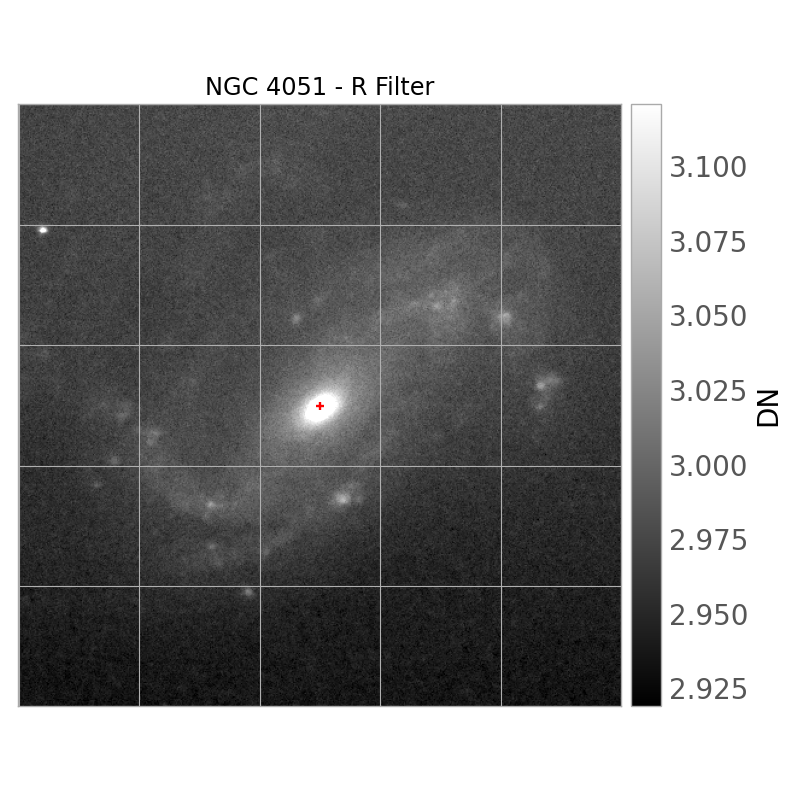

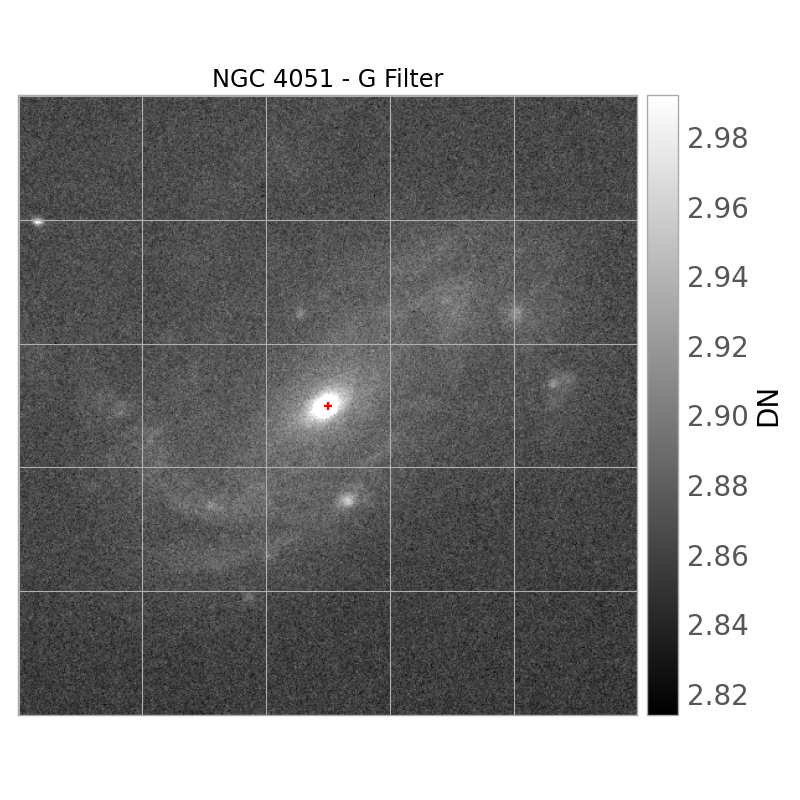

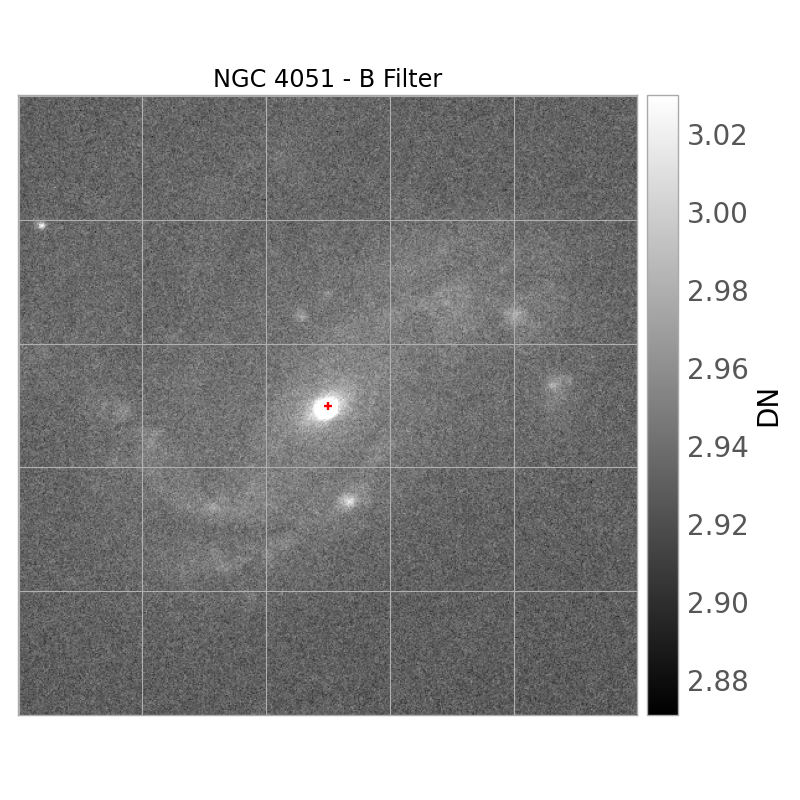

In [27]:
# NGC 4051
graph_indep(data_red_4051, 
            approximateCenter_4051, 
            vbounds=r_4051_scaling, 
            graph = True, 
            title=r"NGC 4051 - R Filter",
            savename="4051r_zoomin",
            radius = 250, save=True)
graph_indep(data_green_4051, 
            approximateCenter_4051, 
            vbounds=g_4051_scaling, 
            graph = True, 
            title=r"NGC 4051 - G Filter",
            savename="4051g_zoomin",
            radius = 250, save=True)
graph_indep(data_blue_4051, 
            approximateCenter_4051, 
            vbounds=b_4051_scaling, 
            graph = True, 
            title=r"NGC 4051 - B Filter",
            savename="4051b_zoomin",
            radius = 250, save=True)

inbounds
inbounds


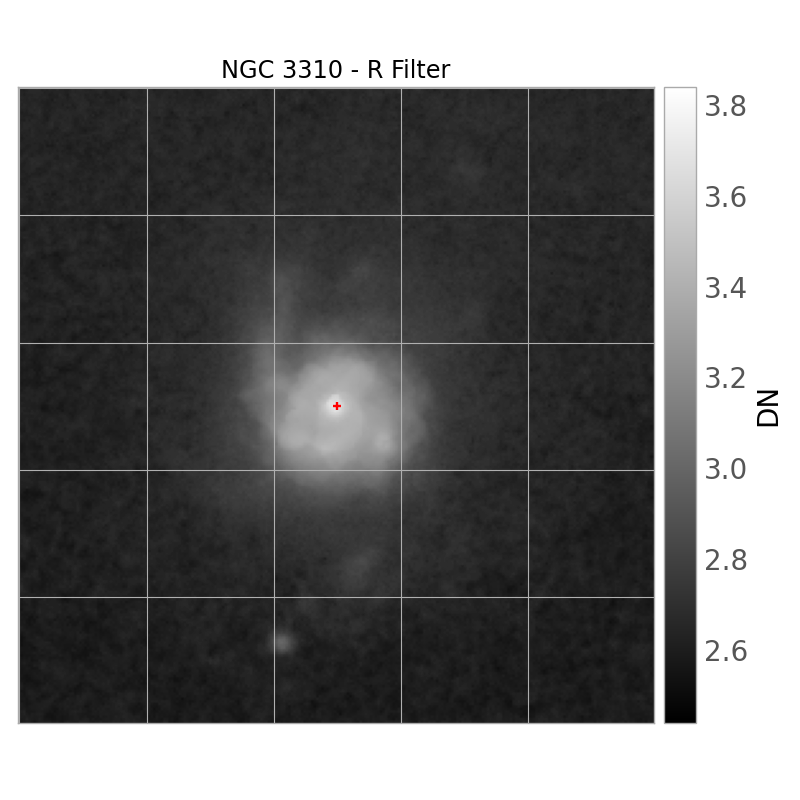

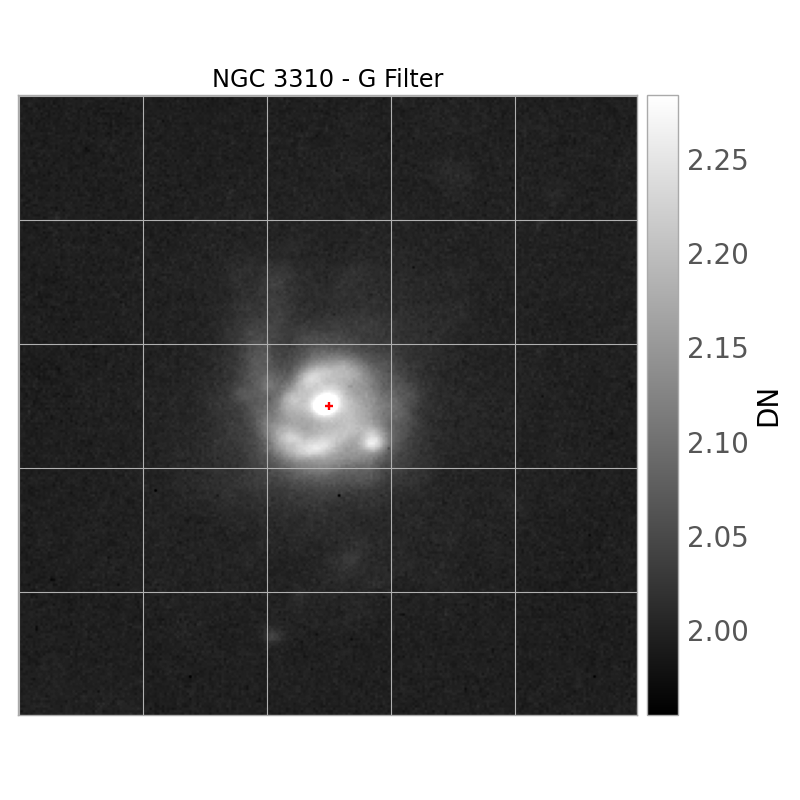

In [40]:
# NGC 3310
graph_indep(data_red_3310, 
            approximateCenter_3310, 
            vbounds= (2.438, 3.841), 
            graph = True, 
            title=r"NGC 3310 - R Filter",
            savename="3310r_zoomin",
            radius = 125, save=True)
graph_indep(data_green_3310, 
            approximateCenter_3310, 
            vbounds=g_3310_scaling, 
            graph = True, 
            title=r"NGC 3310 - G Filter",
            savename="3310g_zoomin",
            radius = 125, save=True)
graph_indep(data_blue_3310, 
            approximateCenter_3310, 
            vbounds=b_3310_scaling, 
            graph = True, 
            title=r"NGC 3310 - B Filter",
            savename="3310b_zoomin",
            radius = 125, save=True)

## Graph 1D Curves: G and B-R

2.87079 3.7047327
2.9310334 3.646704440
2.994121 4.048357f 40
nan nanshed out of 40


Text(0, 0.5, 'Intensity (DN)')

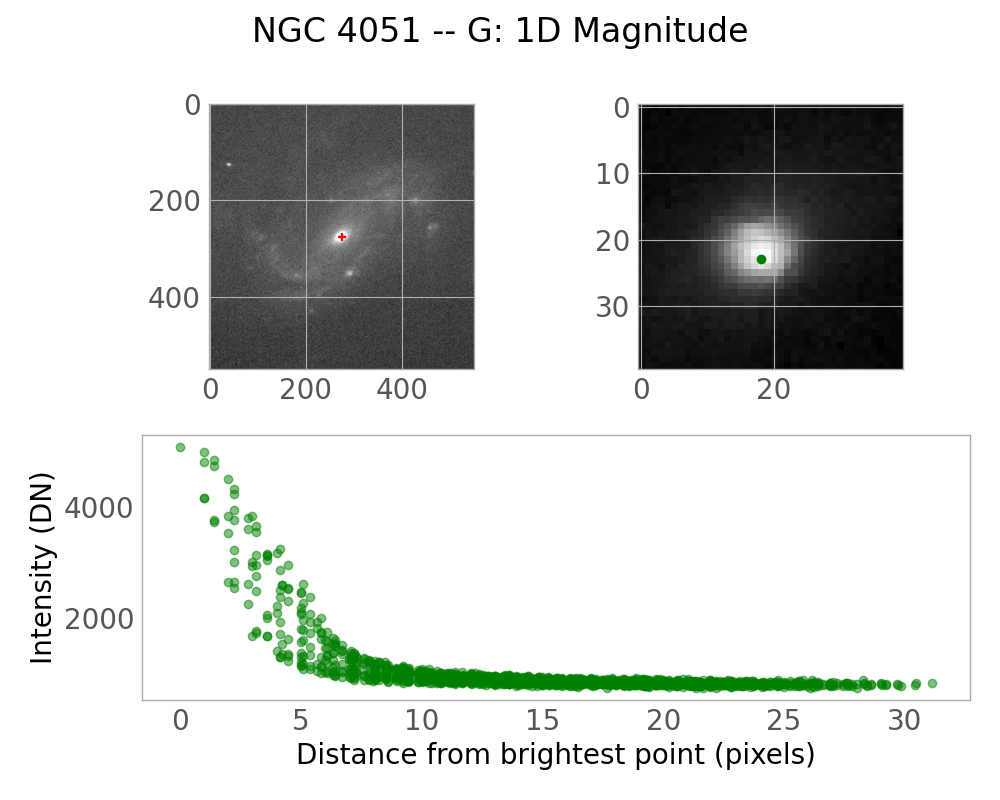

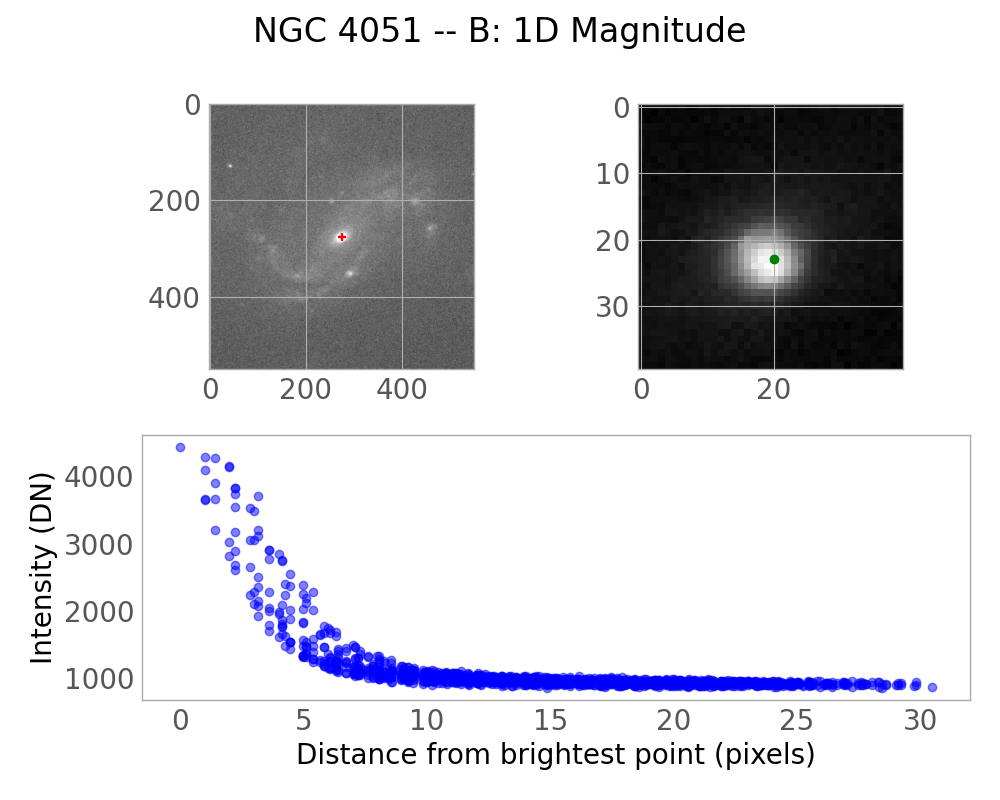

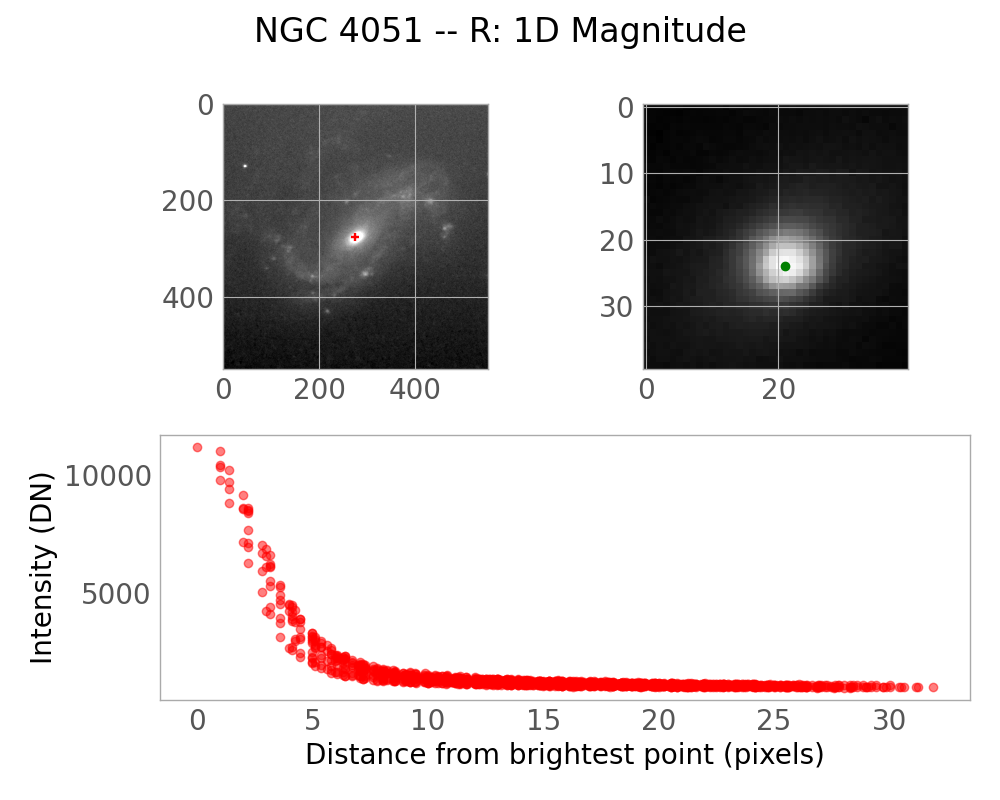

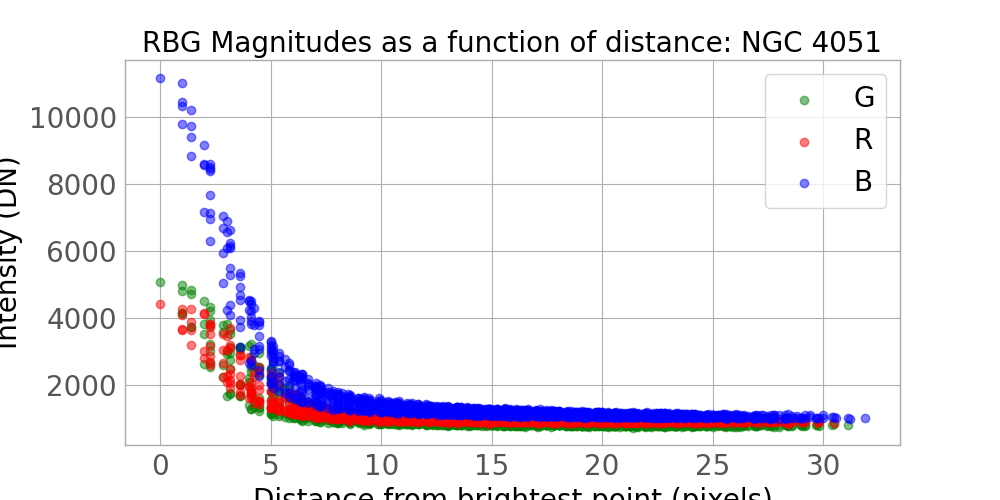

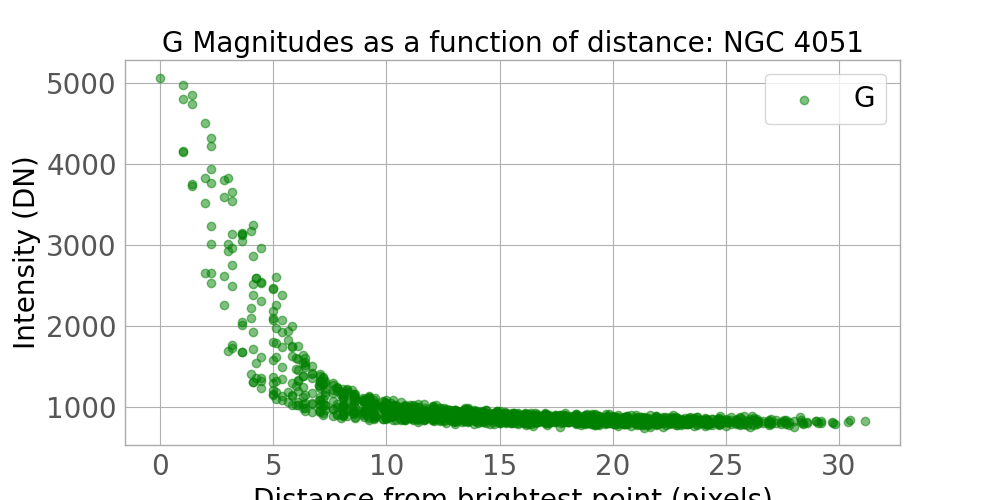

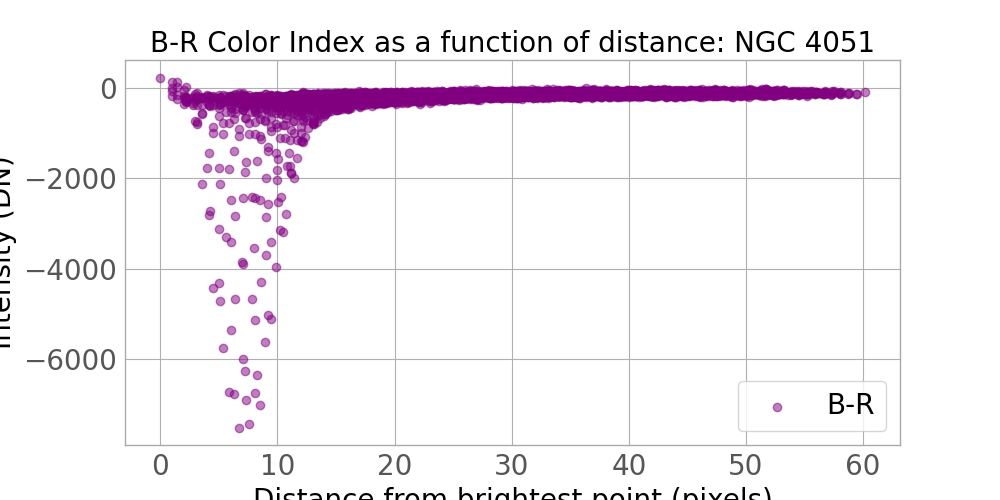

In [79]:
# 4051
green_4051 = graphMaker(data_green_4051, approximateCenter_4051, vbounds = g_4051_scaling, radius_gal = 275, radius_core = 20, graph = True, title='NGC 4051 -- G: 1D Magnitude',save=True, savename="4051G_1D", color = 'g')
blue_4051 = graphMaker(data_blue_4051, approximateCenter_4051, vbounds = b_4051_scaling, radius_gal = 275, radius_core = 20, graph = True, title='NGC 4051 -- B: 1D Magnitude',save=True, savename = "4051B_1D", color = 'b')
red_4051 = graphMaker(data_red_4051, approximateCenter_4051, vbounds = r_4051_scaling, radius_gal = 275, radius_core = 20, graph = True, title='NGC 4051 -- R: 1D Magnitude',save=True, savename = "4051R_1D", color = 'r')
blueMinusred_4051 = graphMaker(data_blue_4051-data_red_4051, approximateCenter_4051, (2,3), graph = False, save=False)

# plt.close('all')
fig, ax = plt.subplots(1,1, figsize = (10,5), sharey=False)
ax.scatter(green_4051[0], green_4051[1], label = 'G', alpha = .5, color = 'green')
ax.scatter(blue_4051[0], blue_4051[1], label = 'R', alpha = .5, color = 'red')
ax.scatter(red_4051[0], red_4051[1], label = 'B', alpha = .5, color = 'blue')
ax.legend()
title = "RBG Magnitudes as a function of distance: NGC 4051"
ax.set_title(title)
ax.set_xlabel("Distance from brightest point (pixels)")
ax.set_ylabel("Intensity (DN)")
# fig.savefig(f'images/RBG_distance_4051.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)

# fig.show()

fig_g, ax_g = plt.subplots(1,1, figsize = (10,5), sharey=False)
ax_g.scatter(green_4051[0], green_4051[1], label = 'G', alpha = .5, color = 'green')
ax_g.legend()
title_g = "G Magnitudes as a function of distance: NGC 4051"
ax_g.set_title(title_g)
ax_g.set_xlabel("Distance from brightest point (pixels)")
ax_g.set_ylabel("Intensity (DN)")
# fig_g.savefig(f'images/G 4051.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
# fig_g.show()

fig_brindex, ax_brindex = plt.subplots(1,1, figsize = (10,5), sharey=False)
ax_brindex.scatter(blueMinusred_4051[0], blueMinusred_4051[1], label = 'B-R', alpha = .5, color = 'purple')
ax_brindex.legend()
title_brindex = "B-R Color Index as a function of distance: NGC 4051"
ax_brindex.set_title("B-R Color Index as a function of distance: NGC 4051")
ax_brindex.set_xlabel("Distance from brightest point (pixels)")
ax_brindex.set_ylabel("Intensity (DN)")
# fig_brindex.savefig(f'images/B-R 4051.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)

# fig_brindex.show()

2.0308025 2.4324827
2.0130267 2.270645 50
2.8692346 3.696326750
nan nanshed out of 50


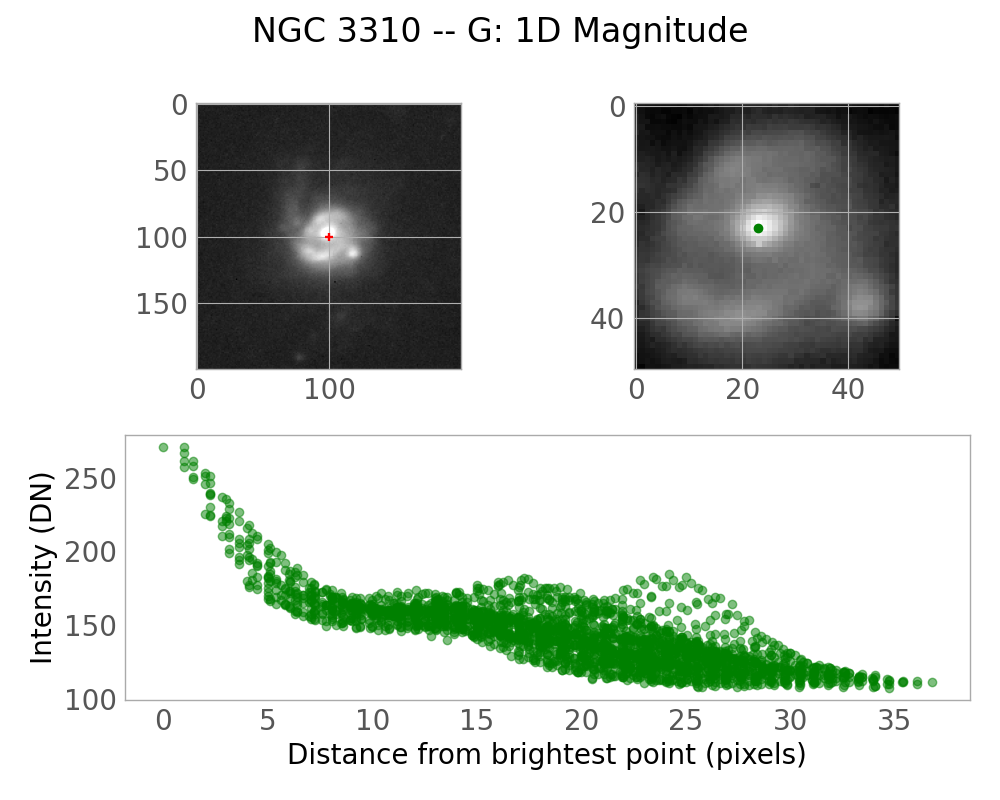

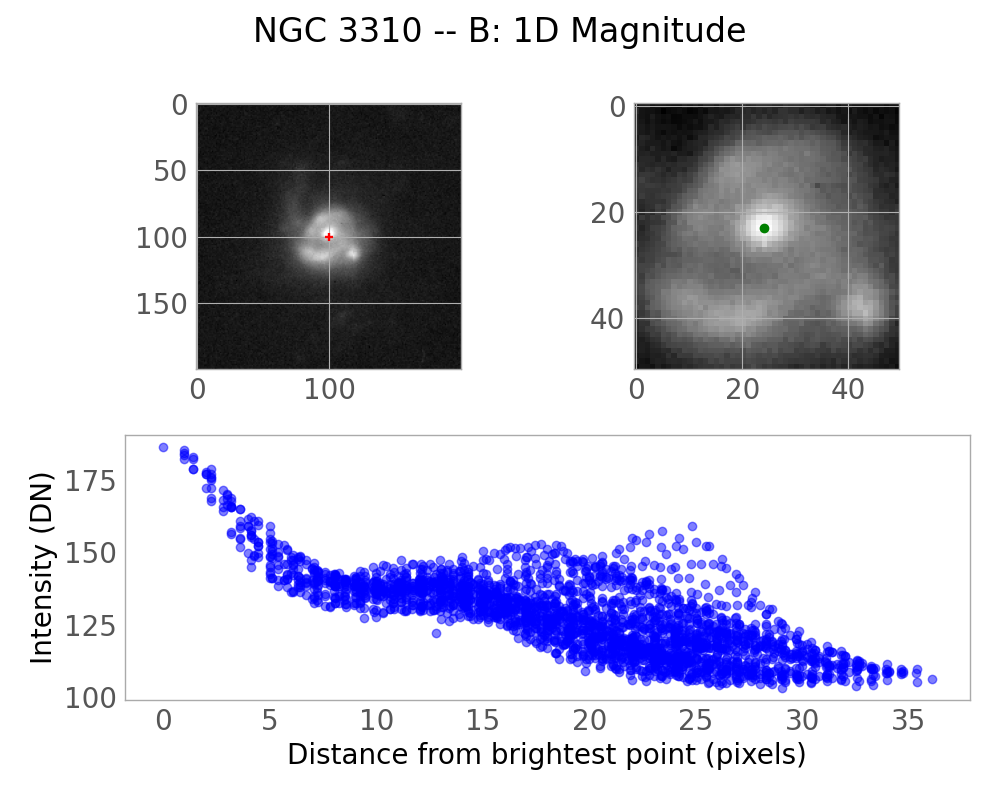

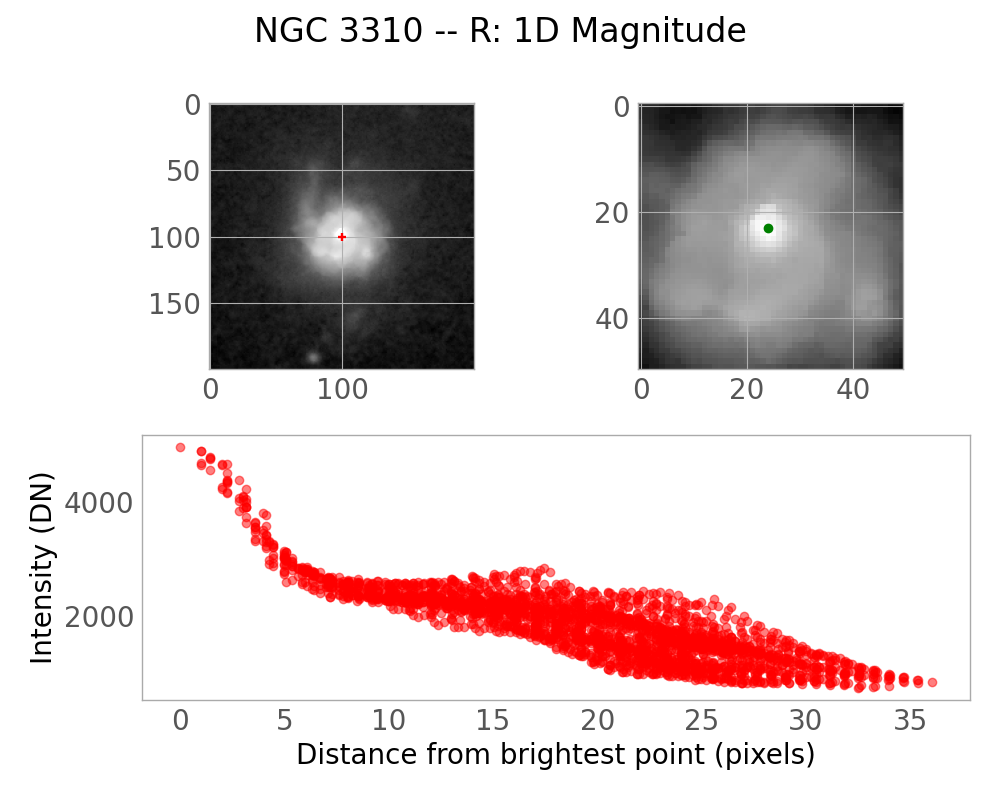

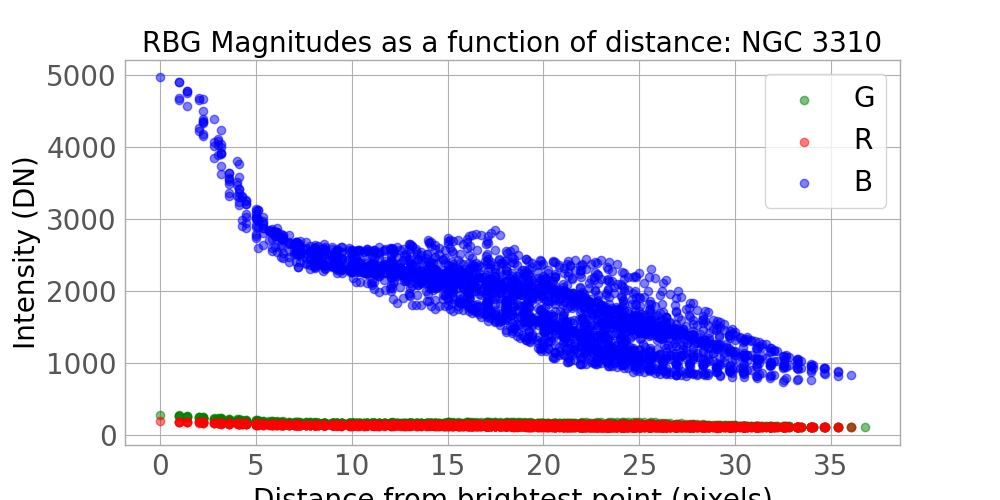

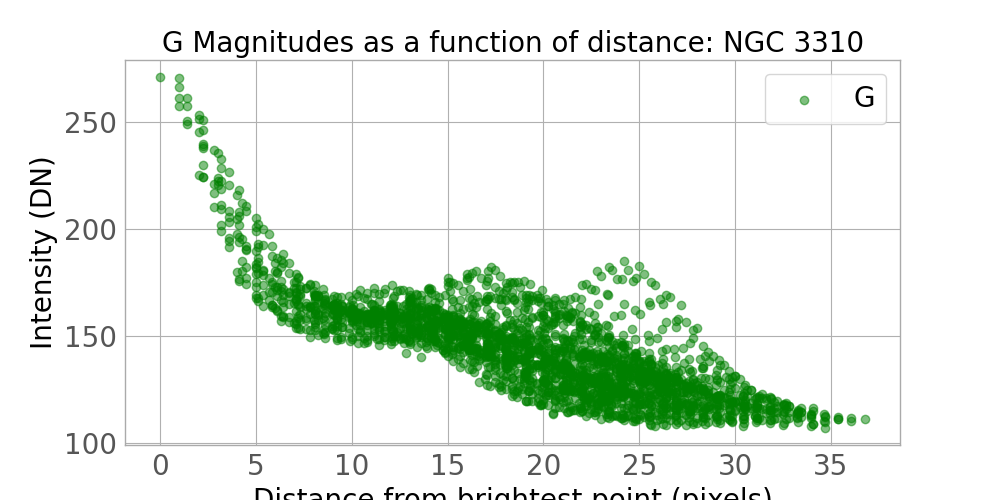

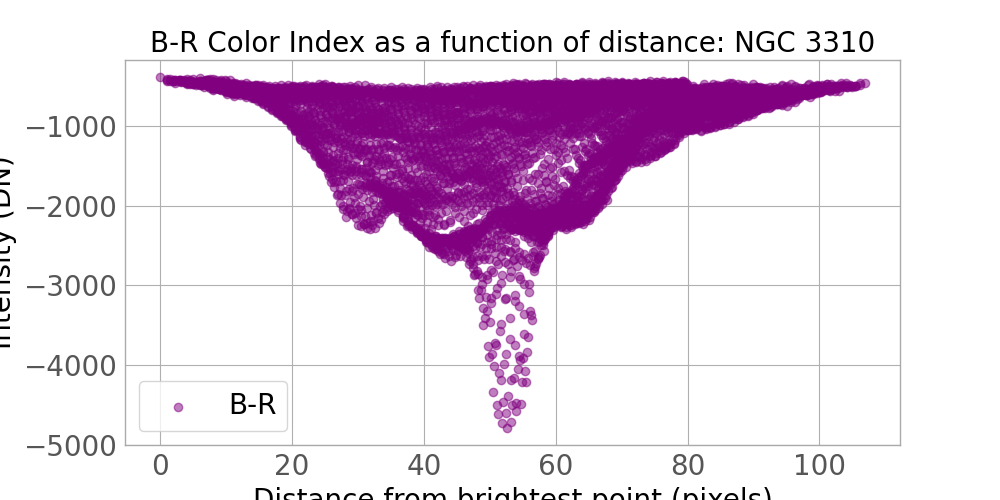

In [81]:
# 3310
green_3310 = graphMaker(data_green_3310, approximateCenter_3310, vbounds = g_3310_scaling, radius_gal = 100, radius_core = 25 , graph = True, title='NGC 3310 -- G: 1D Magnitude',save=True,savename="3310G_1D", color = 'g')
blue_3310 = graphMaker(data_blue_3310, approximateCenter_3310, vbounds = b_3310_scaling, radius_gal = 100, radius_core = 25 , graph = True, title='NGC 3310 -- B: 1D Magnitude',save=True,savename = "3310B_1D", color = 'b')
red_3310 = graphMaker(data_red_3310, approximateCenter_3310, vbounds = r_3310_scaling, radius_gal = 100, radius_core = 25 ,graph = True, title='NGC 3310 -- R: 1D Magnitude',save=True,savename = "3310R_1D", color = 'r')
blueMinusred_3310 = graphMaker(data_blue_3310-data_red_3310, approximateCenter_3310, (2,3),graph = False, save=False)

# plt.close('all')
fig, ax = plt.subplots(1,1, figsize = (10,5), sharey=False)
ax.scatter(green_3310[0], green_3310[1], label = 'G', alpha = .5, color = 'green')
ax.scatter(blue_3310[0], blue_3310[1], label = 'R', alpha = .5, color = 'red')
ax.scatter(red_3310[0], red_3310[1], label = 'B', alpha = .5, color = 'blue')
ax.legend()
title = "RBG Magnitudes as a function of distance: NGC 3310"
ax.set_title(title)
ax.set_xlabel("Distance from brightest point (pixels)")
ax.set_ylabel("Intensity (DN)")
fig.savefig(f'images/RGB_distance_3310.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
# fig.show()




fig_g, ax_g = plt.subplots(1,1, figsize = (10,5), sharey=False)
ax_g.scatter(green_3310[0], green_3310[1], label = 'G', alpha = .5, color = 'green')
ax_g.legend()
title_g = "G Magnitudes as a function of distance: NGC 3310"
ax_g.set_title(title_g)
ax_g.set_xlabel("Distance from brightest point (pixels)")
ax_g.set_ylabel("Intensity (DN)")
fig_g.savefig(f'images/G 3310.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
# fig_g.show()

fig_brindex, ax_brindex = plt.subplots(1,1, figsize = (10,5), sharey=False)
ax_brindex.scatter(blueMinusred_3310[0], blueMinusred_3310[1], label = 'B-R', alpha = .5, color = 'purple')
ax_brindex.legend()
title_brindex = "B-R Color Index as a function of distance: NGC 3310"
ax_brindex.set_title(title_brindex)
ax_brindex.set_xlabel("Distance from brightest point (pixels)")
ax_brindex.set_ylabel("Intensity (DN)")
fig_brindex.savefig(f'images/B-R 3310.png',dpi=300, bbox_inches = 'tight', pad_inches = 0)
# fig_brindex.show()

## Relative Abundances

inbounds
inbounds
inbounds


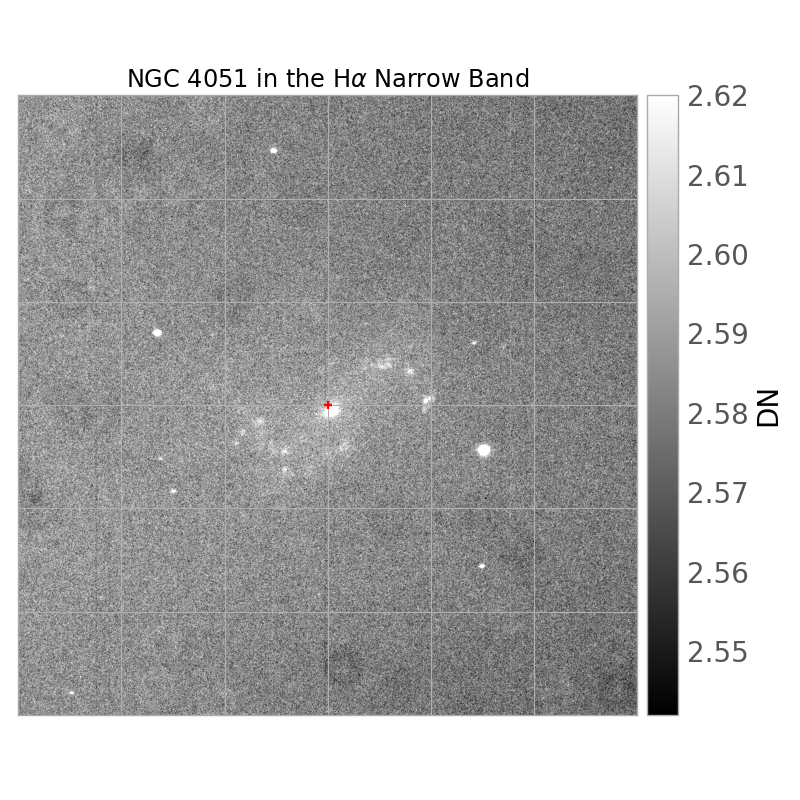

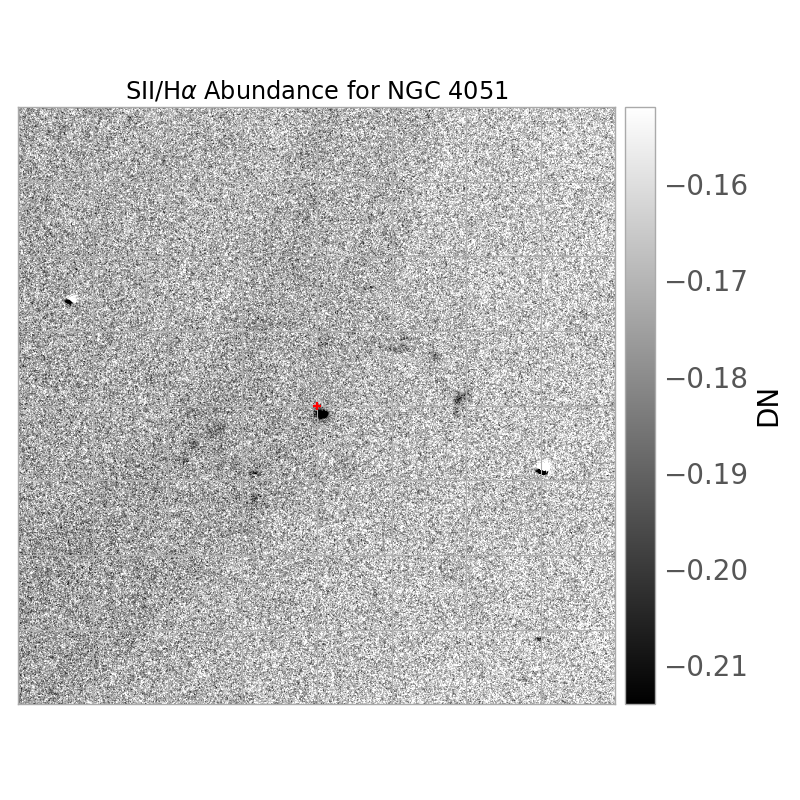

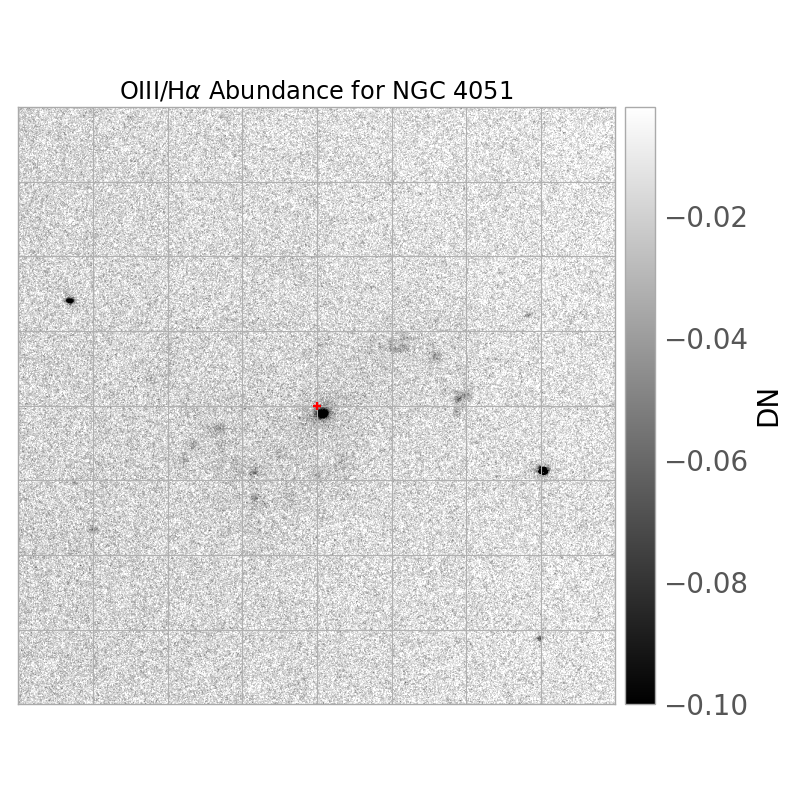

In [20]:
# 4051
graph_indep(data_Ha_4051, 
            approximateCenter_4051,
            vbounds=ha_4051_scaling, 
            graph = True, 
            title=r"NGC 4051 in the H$\alpha$ Narrow Band", 
            savename = "4051Ha",
            radius = 600, save=True)



graph_indep(data_S2_4051/data_Ha_4051, 
            approximateCenter_4051, 
            vbounds=scaling_sh_4051, 
            graph = True, 
            title=r"SII/H$\alpha$ Abundance for NGC 4051",
            savename = "4051sh",
           radius = 400, save=True)



graph_indep(data_O3_4051/data_Ha_4051, 
            approximateCenter_4051, 
            vbounds=scaling_oh_4051, 
            graph = True, 
            title=r"OIII/H$\alpha$ Abundance for NGC 4051",
            savename="4051oh",
            radius = 400, save=True)



inbounds
inbounds
inbounds


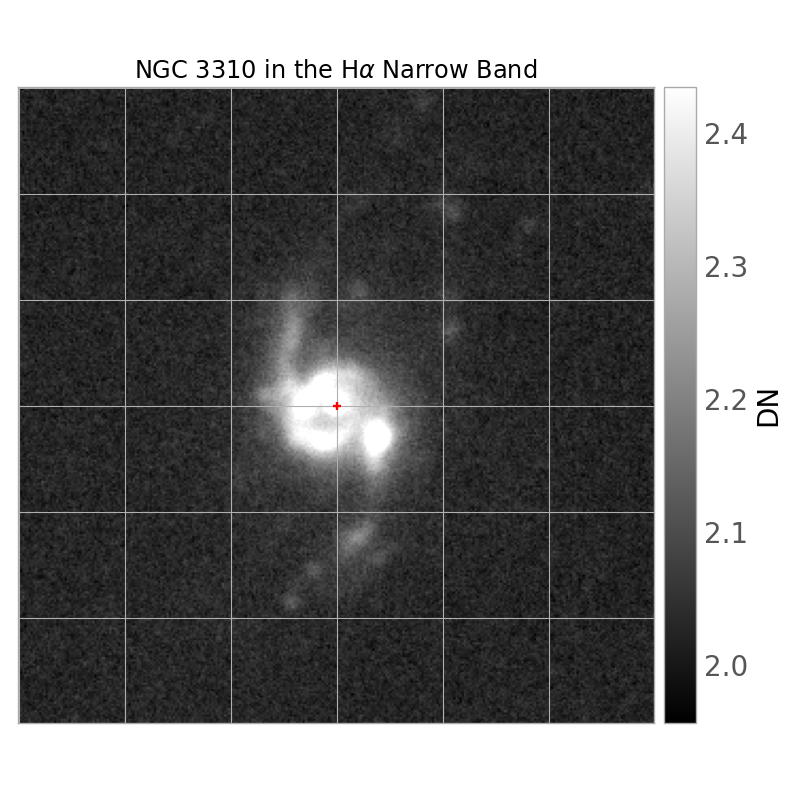

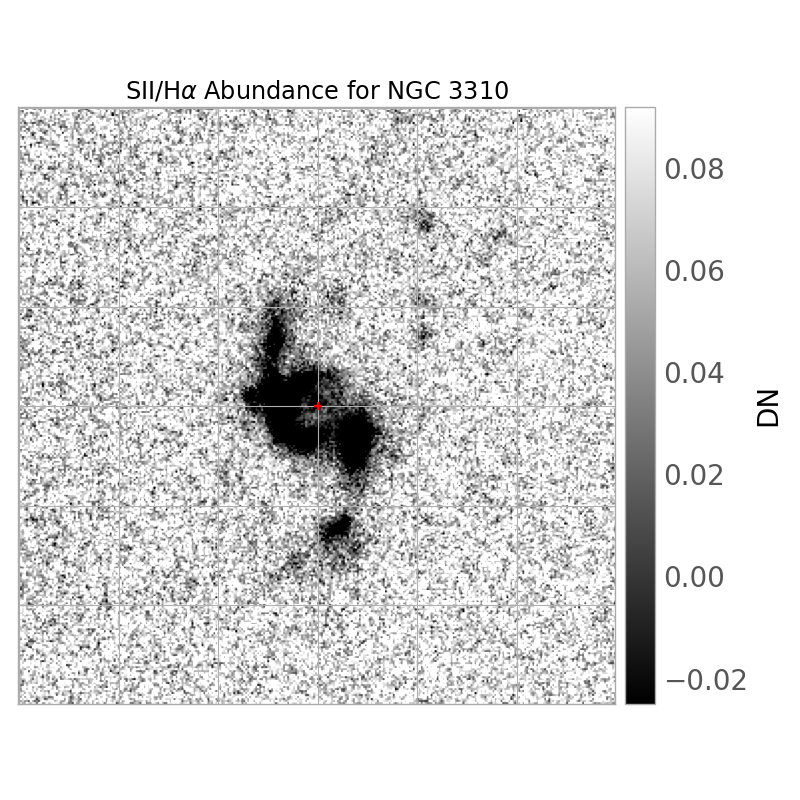

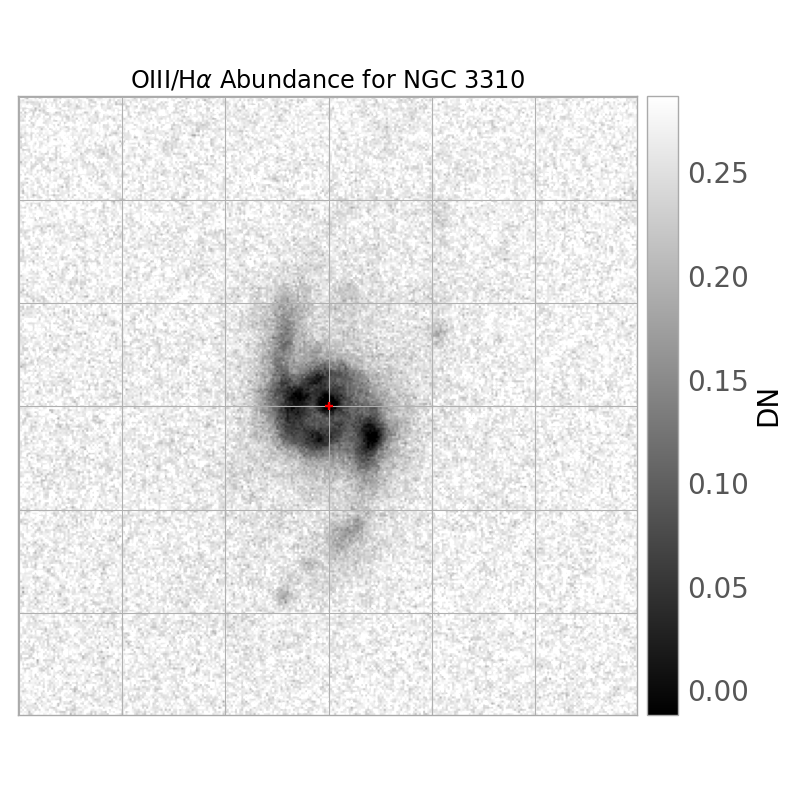

In [21]:
# 3310

graph_indep(data_Ha_3310,
            approximateCenter_3310,
            vbounds=ha_3310_scaling,  
            graph = True, 
            title=r"NGC 3310 in the H$\alpha$ Narrow Band", 
            savename = "3310Ha",
            radius = 150, 
            save=True)



graph_indep(data_S2_3310/data_Ha_3310, 
            approximateCenter_3310, 
            vbounds=scaling_sh_3310, 
            graph = True, 
            title=r"SII/H$\alpha$ Abundance for NGC 3310",
            savename = "3310sh",
           radius = 150, 
            save=True)

            



graph_indep(data_O3_3310/data_Ha_3310, 
            approximateCenter_3310, 
            vbounds=scaling_oh_3310, 
            graph = True, 
            title=r"OIII/H$\alpha$ Abundance for NGC 3310",
            savename="3310oh",
            radius = 150, 
            save=True)



# Garbage

## Not So Real Function

In [ ]:
# path_blue_4051 = 'data/5.7.23_7am_oldimages/Mean NGC4051 LongB.FIT'
# path_red_4051 = 'data/5.7.23_7am_oldimages/Mean NGC4051 LongR.FIT'
# path_green_4051 = 'data/5.7.23_7am_oldimages/Mean NGC4051 LongG.FIT'


# # approximateCenter_4051 = (2770, 1950)
# # Initial Guess based on 1x1 binning
# approximateCenter_4051 = tuple([x//2 for x in approximateCenter_4051_1x1])
# # Correction
# xoffset = 5
# yoffset = 5
# approximateCenter_4051 = (approximateCenter_4051[0] + xoffset, approximateCenter_4051[1] + yoffset)
# print(approximateCenter_4051)



# Vbounds_green = (2.814, 2.992)
# data_green_4051 = loadImageData(path_green_4051,Vbounds_green, graph = False, title='NGC 4051 -- G',save=False)
# plotGalaxy(data_green_4051, approximateCenter_4051, Vbounds_green, radius = 300, graph = False, title='NGC 4051 -- G',save=False)
# green_4051 = graphMaker(data_green_4051, approximateCenter_4051, vbounds = Vbounds_green, radius_gal = 275, graph = False, title='NGC 4051 -- G',save=False)

# Vbounds_blue = (2.871, 3.030)
# data_blue_4051 = loadImageData(path_blue_4051, Vbounds_blue, graph = False, title='NGC 4051 -- B',save=False)
# plotGalaxy(data_blue_4051, approximateCenter_4051, Vbounds_blue, graph = False, title='NGC 4051 -- B',save=False)
# blue_4051 = graphMaker(data_blue_4051, approximateCenter_4051, vbounds = Vbounds_blue, radius_gal = 275, graph = True, title='NGC 4051 -- B',save=False)

# Vbounds_red = (2.919, 3.121)
# data_red_4051 = loadImageData(path_red_4051,Vbounds_red, graph = False, title='NGC 4051 -- R',save=False)
# plotGalaxy(data_red_4051, approximateCenter_4051, Vbounds_red, graph = False, title='NGC 4051 -- R',save=False)
# red_4051 = graphMaker(data_red_4051, approximateCenter_4051, vbounds = Vbounds_red, radius_gal = 275,graph = True, title='NGC 4051 -- R',save=False)

In [ ]:
# path_blue_3310 = 'data/Mean NGC3310 blue.FIT'
# path_red_3310 = 'data/Mean NGC3310 red.FIT'
# path_green_3310 = 'data/Mean NGC3310 green.FIT'

# # approximateCenter_3310 = (2770, 1950)
# # Initial Guess based on 1x1 binning
# approximateCenter_3310 = tuple([x//2 for x in approximateCenter_3310_1x1])
# # Correction
# xoffset = 0
# yoffset = -2
# approximateCenter_3310 = (approximateCenter_3310[0] + yoffset, approximateCenter_3310[1] + xoffset)

# rgal = 75
# rcore = 20
# print(approximateCenter_3310)

# Vbounds_green = (1.955, 2.284)
# data_green_3310 = loadImageData(path_green_3310,Vbounds_green, graph = False, title='NGC 3310 -- G',save=False)
# plotGalaxy(data_green_3310, approximateCenter_3310, Vbounds_green, radius = 300, graph = False, title='NGC 3310 -- G',save=False)
# green_3310 = graphMaker(data_green_3310, approximateCenter_3310, vbounds = Vbounds_green, radius_gal = rgal, radius_core = rcore, graph = True, title='NGC 3310 -- G',save=False)

# Vbounds_blue = (1.972, 2.228)
# data_blue_3310 = loadImageData(path_blue_3310, Vbounds_blue, graph = False, title='NGC 3310 -- B',save=False)
# plotGalaxy(data_blue_3310, approximateCenter_3310, Vbounds_blue, graph = False, title='NGC 3310 -- B',save=False)
# blue_3310 = graphMaker(data_blue_3310, approximateCenter_3310, vbounds = Vbounds_blue, radius_gal = rgal, radius_core = rcore, graph = True, title='NGC 3310 -- B',save=False)

# Vbounds_red = (2.538, 3.541)
# data_red_3310 = loadImageData(path_red_3310,Vbounds_red, graph = False, title='NGC 3310 -- R',save=False)
# plotGalaxy(data_red_3310, approximateCenter_3310, Vbounds_red, graph = False, title='NGC 3310 -- R',save=False)
# red_3310 = graphMaker(data_red_3310, approximateCenter_3310, vbounds = Vbounds_red, radius_gal = rgal, radius_core = rcore, graph = True, title='NGC 3310 -- R',save=False)

In [ ]:
# plotGalaxy(data_blue_4051-data_red_4051, approximateCenter_4051, graph=False, save=False)
# blueMinusred_4051 = graphMaker(data_blue_4051-data_red_4051, approximateCenter_4051, (2,3),graph = False, save=False)

# # plt.close('all')
# fig, ax = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax.scatter(green_4051[0], green_4051[1], label = 'G', alpha = .5, color = 'green')
# ax.scatter(blue_4051[0], blue_4051[1], label = 'R', alpha = .5, color = 'red')
# ax.scatter(red_4051[0], red_4051[1], label = 'B', alpha = .5, color = 'blue')
# ax.legend()
# ax.set_title("RBG Magnitudes as a function of distance: NGC 4051")
# ax.set_xlabel("Distance from brightest point (pixels)")
# ax.set_ylabel("Intensity")
# # fig.show()

# fig_g, ax_g = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_g.scatter(green_4051[0], green_4051[1], label = 'G', alpha = .5, color = 'green')
# ax_g.legend()
# ax_g.set_title("G Magnitudes as a function of distance: NGC 4051")
# ax_g.set_xlabel("Distance from brightest point (pixels)")
# ax_g.set_ylabel("Intensity")
# # fig_g.show()

# fig_brindex, ax_brindex = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_brindex.scatter(blueMinusred_4051[0], blueMinusred_4051[1], label = 'B-R', alpha = .5, color = 'purple')
# ax_brindex.legend()
# ax_brindex.set_title("B-R Color Index as a function of distance: NGC 4051")
# ax_brindex.set_xlabel("Distance from brightest point (pixels)")
# ax_brindex.set_ylabel("Intensity")
# # fig_brindex.show()

In [ ]:
# plotGalaxy(data_blue_3310-data_red_3310, approximateCenter_3310, graph=False, save=False)
# blueMinusred_3310 = graphMaker(data_blue_3310-data_red_3310, approximateCenter_3310, (2,3),graph = False, save=False)

# # plt.close('all')
# fig, ax = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax.scatter(green_3310[0], green_3310[1], label = 'G', alpha = .5, color = 'green')
# ax.scatter(blue_3310[0], blue_3310[1], label = 'R', alpha = .5, color = 'red')
# ax.scatter(red_3310[0], red_3310[1], label = 'B', alpha = .5, color = 'blue')
# ax.legend()
# ax.set_title("RBG Magnitudes as a function of distance: NGC 3310")
# ax.set_xlabel("Distance from brightest point (pixels)")
# ax.set_ylabel("Intensity")
# # fig.show()

# fig_g, ax_g = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_g.scatter(green_3310[0], green_3310[1], label = 'G', alpha = .5, color = 'green')
# ax_g.legend()
# ax_g.set_title("G Magnitudes as a function of distance: NGC 3310")
# ax_g.set_xlabel("Distance from brightest point (pixels)")
# ax_g.set_ylabel("Intensity")
# # fig_g.show()

# fig_brindex, ax_brindex = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_brindex.scatter(blueMinusred_3310[0], blueMinusred_3310[1], label = 'B-R', alpha = .5, color = 'purple')
# ax_brindex.legend()
# ax_brindex.set_title("B-R Color Index as a function of distance: NGC 3310")
# ax_brindex.set_xlabel("Distance from brightest point (pixels)")
# ax_brindex.set_ylabel("Intensity")
# # fig_brindex.show()

In [ ]:
# fig, ax = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax.scatter(green_3310[0], green_3310[1], label = 'G', alpha = .5, color = 'green')
# ax.scatter(blue_3310[0], blue_3310[1], label = 'R', alpha = .5, color = 'red')
# ax.scatter(red_3310[0], red_3310[1], label = 'B', alpha = .5, color = 'blue')
# ax.legend()
# ax.set_title("RBG Magnitudes as a function of distance: NGC 3310")
# ax.set_xlabel("Distance from brightest point (pixels)")
# ax.set_ylabel("Intensity")
# fig.show()

# fig_g, ax_g = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_g.scatter(green_3310[0], green_3310[1], label = 'G', alpha = .5, color = 'green')
# ax_g.legend()
# ax_g.set_title("G Magnitudes as a function of distance: NGC 3310")
# ax_g.set_xlabel("Distance from brightest point (pixels)")
# ax_g.set_ylabel("Intensity")
# fig_g.show()

# fig_brindex, ax_brindex = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_brindex.scatter(blueMinusred_3310[0], blueMinusred_3310[1], label = 'B-R', alpha = .5, color = 'purple')
# ax_brindex.legend()
# ax_brindex.set_title("B-R Color Index as a function of distance: NGC 3310")
# ax_brindex.set_xlabel("Distance from brightest point (pixels)")
# ax_brindex.set_ylabel("Intensity")
# fig_brindex.show()

In [ ]:
# #Comparing Magnitude Distances


# fig_g_comp, ax_g_comp = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_g_comp.scatter(green_3310[0], green_3310[1], label = 'NGC 3310', alpha = .5, color = 'green')
# ax_g_comp.scatter(green_4051[0], green_4051[1], label = 'NGC 4051', alpha = .5, color = 'blue')
# ax_g_comp.legend()
# ax_g_comp.set_title("Comparison of G Magnitudes as a function of distance")
# ax_g_comp.set_xlabel("Distance from brightest point (pixels)")
# ax_g_comp.set_ylabel("Intensity (DN)")
# ax_g_comp.grid(False)
# fig_g_comp.show()

# fig_br_comp, ax_brindex_comp = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_brindex_comp.scatter(blueMinusred_3310[0], blueMinusred_3310[1], label = 'NGC 3310', alpha = .5, color = 'green')
# ax_brindex_comp.scatter(blueMinusred_4051[0], blueMinusred_4051[1], label = 'NGC 4051', alpha = .5, color = 'blue')
# ax_brindex_comp.legend()
# ax_brindex_comp.set_title("Comparison of B-R Color Index as a function of distance")
# ax_brindex_comp.set_xlabel("Distance from brightest point (pixels)")
# ax_brindex_comp.set_ylabel("Intensity (DN)")
# ax_brindex_comp.grid(False)
# fig_br_comp.show()

# fig_g_comp.savefig("Images/CompGMag.png")
# fig_br_comp.savefig("Images/CompBRIndex.png")

In [ ]:
# #Comparing Magnitude Distances
# def graph1DSeperate(graphcolor, **graphdata):
#     fig, ax = plt.subplots(1,1, figsize = (10,5), sharey=True)
#     for name, data in graphdata.items():
#         ax.scatter(data[0], data[1], label = f'NGC {name[-4:]}', alpha = .5)
#     ax.legend()
#     ax.set_title(f"Comparison of {graphcolor} Magnitudes as a function of distance")
#     ax.set_xlabel("Distance from brightest point (pixels)")
#     ax.set_ylabel("Intensity (DN)")
#     ax.grid(False)

# graph1DSeperate('G', NGC3310=green_3310, NGC4051=green_4051)h
# graph1DSeperate('B-R', NGC3301 = blueMinusred_3310, NGC4051 = blueMinusred_4051 )

# fig_g_comp, ax_g_comp = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_g_comp.scatter(green_3310[0], green_3310[1], label = 'NGC 3310', alpha = .5, color = 'green')
# ax_g_comp.scatter(green_4051[0], green_4051[1], label = 'NGC 4051', alpha = .5, color = 'blue')
# ax_g_comp.legend()
# ax_g_comp.set_title("Comparison of G Magnitudes as a function of distance")
# ax_g_comp.set_xlabel("Distance from brightest point (pixels)")
# ax_g_comp.set_ylabel("Intensity (DN)")
# ax_g_comp.grid(False)
# fig_g_comp.show()

# fig_br_comp, ax_brindex_comp = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_brindex_comp.scatter(blueMinusred_3310[0], blueMinusred_3310[1], label = 'NGC 3310', alpha = .5, color = 'green')
# ax_brindex_comp.scatter(blueMinusred_4051[0], blueMinusred_4051[1], label = 'NGC 4051', alpha = .5, color = 'blue')
# ax_brindex_comp.legend()
# ax_brindex_comp.set_title("Comparison of B-R Color Index as a function of distance")
# ax_brindex_comp.set_xlabel("Distance from brightest point (pixels)")
# ax_brindex_comp.set_ylabel("Intensity (DN)")
# ax_brindex_comp.grid(False)
# fig_br_comp.show()

# fig_g_comp.savefig("Images/CompGMag.png")
# fig_br_comp.savefig("Images/CompBRIndex.png")

In [ ]:
# path_blue_4051 = 'data/5.7.23_7am_oldimages/Mean NGC4051 LongB.FIT'
# path_red_4051 = 'data/5.7.23_7am_oldimages/Mean NGC4051 LongR.FIT'
# path_green_4051 = 'data/5.7.23_7am_oldimages/Mean NGC4051 LongG.FIT'
# path_ha_4051 = 'data/5.7.23_3am/Mean NGC4051 halpha.FIT'
# path_s2_4051 = 'data/5.7.23_3am/Mean NGC4051 sii.FIT'
# path_o3_4051 = 'data/5.7.23_3am/Mean NGC4051 oiii.FIT'

# ha_4051_scaling = (2.542, 2.620)
# o3_4051_scaling = (2.546, 2.585)
# s2_4051_scaling = (2.391, 2.437)
# scaling_sh_4051 = (-.214, -.152)
# scaling_oh_4051 = (-.100, -0.002)



# approximateCenter_4051 = (1380, 972)
# # approximateHa_4051 = np.array([[100, 200],[300, 55]])
# data_Ha_4051 = loadImageData(path_ha_4051, vbounds=ha_4051_scaling, graph = False, save=False)
# graph_indep(data_Ha_4051, approximateCenter_4051,vbounds=ha_4051_scaling,  graph = True, 
#             title=r"NGC 4051 in the H$\alpha$ Narrow Band", 
#             radius = 600, save=False)
# # Ha_4051 = graphMaker_Ha(data_green_4051, approximateCenter_4051, approximateHa_4051, graph = True)

# data_S2_4051 = loadImageData(path_s2_4051,graph = False, save=False)
# graph_indep(data_S2_4051/data_Ha_4051, approximateCenter_4051, vbounds=scaling_sh_4051, graph = True, 
#             title=r"SII/H$\alpha$ Abundance for NGC 4051",
#            radius = 400, save=False)
# # blue_4051 = graphMaker_core(data_blue_4051, approximateCenter_4051, graph = False)

# data_O3_4051 = loadImageData(path_o3_4051,graph = False, save=False)
# graph_indep(data_O3_4051/data_Ha_4051, approximateCenter_4051, vbounds=scaling_oh_4051, graph = True, 
#             title=r"OIII/H$\alpha$ Abundance for NGC 4051",
#             radius = 400, save=False)
# # red_4051 = graphMaker_core(data_red_4051, approximateCenter_4051, graph = False)
# # blueMinusred_4051 = graphMaker_core(testData2-testData1, approximateCenter_4051, graph = False)


In [ ]:
# path_blue_3310 = 'data/5.7.23_3am/Mean ngc3310.GSC blue.FIT'
# path_red_3310 = 'data/5.7.23_3am/Mean ngc3310.GSC red.FIT'
# path_green_3310 = 'data/5.7.23_3am/Mean ngc3310 green.GSC.FIT'
# path_ha_3310 = 'data/5.7.23_3am/Mean NGC3310 halpha.FIT'

# path_s2_3310 = 'data/5.7.23_3am/Mean NGC3310 sii.FIT'
# path_o3_3310 = 'data/5.7.23_3am/Mean NGC3310 oiii.FIT'


# ha_3310_scaling = (1.956, 2.435)
# o3_3310_scaling = (2.261, 2.485)
# s2_3310_scaling = (1.929, 2.447)
# scaling_sh_3310 = (-0.025, 0.092)
# scaling_oh_3310 = (-0.0119, 0.2870)



# approximateCenter_3310 = (1032, 1212)
# # approximateHa_3310 = np.array([[100, 200],[300, 55]])
# data_Ha_3310 = loadImageData(path_ha_3310, vbounds=ha_3310_scaling, graph = False, save=False)
# graph_indep(data_Ha_3310, approximateCenter_3310,vbounds=ha_3310_scaling,  graph = True, 
#             title=r"NGC 3310 in the H$\alpha$ Narrow Band", 
#             radius = 150, save=False)
# # Ha_3310 = graphMaker_Ha(data_green_3310, approximateCenter_3310, approximateHa_3310, graph = True)

# data_S2_3310 = loadImageData(path_s2_3310,graph = False, save=False)
# graph_indep(data_S2_3310/data_Ha_3310, approximateCenter_3310, vbounds=scaling_sh_3310, graph = True, 
#             title=r"SII/H$\alpha$ Abundance for NGC 3310",
#            radius = 150, save=False)
# # blue_3310 = graphMaker_core(data_blue_3310, approximateCenter_3310, graph = False)

# data_O3_3310 = loadImageData(path_o3_3310,graph = False, save=False)
# graph_indep(data_O3_3310/data_Ha_3310, approximateCenter_3310, vbounds=scaling_oh_3310, graph = True, 
#             title=r"OIII/H$\alpha$ Abundance for NGC 3310",
#             radius = 150, save=False)
# # red_3310 = graphMaker_core(data_red_3310, approximateCenter_3310, graph = False)
# # blueMinusred_3310 = graphMaker_core(testData2-testData1, approximateCenter_3310, graph = False)


In [ ]:
# path_blue_3310 = 'data/5.7.23_3am/Mean ngc3310.GSC blue.FIT'
# path_red_3310 = 'data/5.7.23_3am/Mean ngc3310.GSC red.FIT'
# path_green_3310 = 'data/5.7.23_3am/Mean ngc3310 green.GSC.FIT'
# path_ha_3310 = 'data/5.7.23_3am/Mean NGC3310 halpha.FIT'

# path_s2_3310 = 'data/5.7.23_3am/Mean NGC3310 sii.FIT'
# path_o3_3310 = 'data/5.7.23_3am/Mean NGC3310 oiii.FIT'




# approximateCenter_3310 = (1032, 1212)
# # approximateHa_3310 = np.array([[10, 20],[30, 55]])
# data_Ha_3310 = loadImageData(path_ha_3310, (1.9,2.3),graph = False, save=False)
# plotGalaxy(data_Ha_3310, approximateCenter_3310, (2,2.3),graph = False, radius = 160, save=False)
# # Ha_3310 = graphMaker(data_HA_3310, approximateCenter_3310, approximateHa_3310, graph = True, radius_gal = 160)

# data_S2_3310 = loadImageData(path_s2_3310,graph = False, save=False)
# data_O3_3310 = loadImageData(path_o3_3310,graph = False, save=False)
# plotGalaxy(data_S2_3310/data_Ha_3310, approximateCenter_3310,graph = True, radius = 160, title=r'SII/H$\alpha$ for NGC 3310', save=False)
# plotGalaxy(data_O3_3310/data_Ha_3310, approximateCenter_3310,graph = True, radius = 160, title=r'OIII/H$\alpha$ for NGC3310', save=False)


# # blue_3310 = graphMaker_core(data_blue_3310, approximateCenter_3310, graph = False)



# # plotGalaxy(data_O3_3310, approximateCenter_3310, (2.5,2.7),graph = True, radius = 200)
# # red_3310 = graphMaker_core(data_red_3310, approximateCenter_3310, graph = False)
# # blueMinusred_3310 = graphMaker_core(testData2-testData1, approximateCenter_3310, graph = False)


In [ ]:

# # plt.close('all')
# fig, ax = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax.scatter(green_4051[0], green_4051[1], label = 'G', alpha = .5, color = 'green')
# ax.scatter(blue_4051[0], blue_4051[1], label = 'R', alpha = .5, color = 'red')
# ax.scatter(red_4051[0], red_4051[1], label = 'B', alpha = .5, color = 'blue')
# ax.legend()
# ax.set_title("RBG Magnitudes as a function of distance: NGC 4051")
# ax.set_xlabel("Distance from brightest point (pixels)")
# ax.set_ylabel("Intensity")
# fig.show()

# fig_g, ax_g = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_g.scatter(green_4051[0], green_4051[1], label = 'G', alpha = .5, color = 'green')
# ax_g.legend()
# ax_g.set_title("G Magnitudes as a function of distance: NGC 4051")
# ax_g.set_xlabel("Distance from brightest point (pixels)")
# ax_g.set_ylabel("Intensity")
# fig_g.show()

# fig_brindex, ax_brindex = plt.subplots(1,1, figsize = (10,5), sharey=True)
# ax_brindex.scatter(blueMinusred_4051[0], blueMinusred_4051[1], label = 'B-R', alpha = .5, color = 'purple')
# ax_brindex.legend()
# ax_brindex.set_title("B-R Color Index as a function of distance: NGC 4051")
# ax_brindex.set_xlabel("Distance from brightest point (pixels)")
# ax_brindex.set_ylabel("Intensity")
# fig_brindex.show()


In [ ]:
# def graphMaker_helper(image, aproxCent, approxHa=None, vbounds = None, graph = True, title = "Approximate Galaxy Zoom-In", radius_gal = 600, radius_core = 50, radius_clust = 40):
#     if approxHa is None: approxTarget, radius_target = aproxCent, radius_core
#     else: approxTarget, radius_target = approxHa, radius_clust
#      #Crop image down to galaxy size
#     xmin, xmax = aproxCent[0]-radius_gal, aproxCent[0]+radius_gal
#     ymin, ymax = aproxCent[1]-radius_gal, aproxCent[1]+radius_gal
# #     print(xmin, xmax, ymin, ymax)
# #     print(image.shape)
#     image_cropped = image[xmin:xmax, ymin:ymax]
# #     print(image_cropped)
#     minval = np.amin(np.log10(image_cropped))
#     maxval = np.amax(np.log10(image_cropped))
    
#     print(minval,maxval)
#     if vbounds is not None: minval , maxval = vbounds
#     print(minval, maxval)
#     xmin_target, xmax_target = aproxCent[0]-radius_target, aproxCent[0]+radius_target
#     ymin_target, ymax_target = aproxCent[1]-radius_target, aproxCent[1]+radius_target
#     image_target_cropped = image[xmin_target:xmax_target, ymin_target:ymax_target]
#     target_image = image_target_cropped
       

#     minval_target = np.amin(np.log10(target_image))
#     maxval_target = np.amax(np.log10(target_image))

    
    
#     # Now that we have the general idea of where the center is, the max value in the array can be used as the absolute center
#     center = np.where(target_image == np.amax(target_image))
#     cool_distance = np.array([])
#     cool_brightness = np.array([])
#     # fig, ax = plt.subplots()
#     for i,v in enumerate(target_image):
#         for j,u in enumerate(v):
#             cool_distance = np.append(cool_distance, distanceFinder(center, (i,j)))
#             # print(cool_distance)
#             cool_brightness = np.append(cool_brightness, u)
#             # cool = [distanceFinder(center, (i,j)), u]
#         print(f'{i} finished out of {len(target_image)}', end='\r')
#     # print(len(cool_distance), len(cool_brightness))
#             # print(f'{cool} given the coordinates were ({i},{j})')
#     if graph: 
#         fig = plt.figure(tight_layout=True)
#         gs = gridspec.GridSpec(2, 2)
#         ax_gal = fig.add_subplot(gs[0,0])
#         ax_zoom = fig.add_subplot(gs[0,1])
#         ax_graph = fig.add_subplot(gs[1,:])
        
#         ax_gal.imshow(np.log10(image_cropped), cmap='gray', vmin=minval, vmax=maxval)
#         fig.suptitle(title)
#         ax_gal.scatter(radius_gal, radius_gal, color='red', marker="+")
#         # ax_gal.scatter(approxHa[0], approxHa[1], color='green', marker = '.')
#         ax_zoom.imshow(np.log10(target_image), cmap='gray', vmin=minval_target, vmax=maxval_target)
#         ax_zoom.scatter(center[1], center[0], color='green', marker='o')
    
#         ax_graph.scatter(cool_distance, cool_brightness, marker='.')
#     return np.array([cool_distance, cool_brightness])
    
    
# path_green_4051 = 'Mean_4-12_4051/Mean G-Long NGC4051.GSC_REALIGN.FIT'

# approximateCenter_4051 = (2770, 1950)
# data_green_4051 = loadImageData(path_green_4051, (2.1, 2.35), graph = False, title='NGC 4051 -- G')
# # plotGalaxy(data_green_4051, approximateCenter_4051, (2.1,2.35), graph = False, title='NGC 4051 -- G')
# # print(data_green_4051)
# green_4051 = graphMaker_helper(data_green_4051, approximateCenter_4051, vbounds=(2.1,2.35), graph = True, title='NGC 4051 -- G')
# green_4051 = graphMaker(data_green_4051, approximateCenter_4051, vbounds=(2.1,2.35), graph = True, title='NGC 4051 -- G')




# # path_green_4051 = 'Mean_4-12_4051/Mean G-Long NGC4051.GSC_REALIGN.FIT'

# # approximateCenter_4051 = (2770, 1950)
# # data_green_4051 = loadImageData(path_green_4051,(2.1,2.35), graph = True, title='NGC 4051 -- G')

In [ ]:
# def graphMaker(image, aproxCent, approxHa=None, vbounds = None, graph = True, title = "Approximate Galaxy Zoom-In", radius_gal = 600, radius_core = 50, radius_clust = 40, filename=None):
#     if approxHa is None: approxTarget, radius_target = aproxCent, radius_core
#     else: approxTarget, radius_target = approxHa, radius_clust
#      #Crop image down to galaxy size
#     xmin, xmax = aproxCent[0]-radius_gal, aproxCent[0]+radius_gal
#     ymin, ymax = aproxCent[1]-radius_gal, aproxCent[1]+radius_gal

#     image_cropped = image[xmin:xmax, ymin:ymax]
#     minval = np.amin(np.log10(image_cropped))
#     maxval = np.amax(np.log10(image_cropped))
#     print(minval, maxval)
#     if vbounds is not None: minval, maxval = vbounds
#     print(minval, maxval)


#     xmin_target, xmax_target = aproxCent[0]-radius_target, aproxCent[0]+radius_target
#     ymin_target, ymax_target = aproxCent[1]-radius_target, aproxCent[1]+radius_target
#     image_target_cropped = image[xmin_target:xmax_target, ymin_target:ymax_target]
#     target_image = image_target_cropped

#     minval_target = np.amin(np.log10(target_image))
#     maxval_target = np.amax(np.log10(target_image))

#     # Now that we have the general idea of where the center is, the max value in the array can be used as the absolute center
#     center = np.where(target_image == np.amax(target_image))
#     cool_distance = np.array([])
#     cool_brightness = np.array([])
#     # fig, ax = plt.subplots()
    
    
    
    
#     for i,v in enumerate(target_image):
#         for j,u in enumerate(v):
#             cool_distance = np.append(cool_distance, distanceFinder(center, (i,j)))
#             # print(cool_distance)
#             cool_brightness = np.append(cool_brightness, u)
#             # cool = [distanceFinder(center, (i,j)), u]
#         print(f'{i} finished out of {len(target_image)}', end='\r')
#     # print(len(cool_distance), len(cool_brightness))
#             # print(f'{cool} given the coordinates were ({i},{j})')
#     result = np.array([cool_distance, cool_brightness])
#     if graph: 
#         fig = plt.figure(tight_layout=True)
#         gs = gridspec.GridSpec(2, 2)
#         ax_gal = fig.add_subplot(gs[0,0])
#         ax_zoom = fig.add_subplot(gs[0,1])
#         ax_graph = fig.add_subplot(gs[1,:])
        
#         ax_gal.imshow(np.log10(image_cropped), cmap='gray', vmin=minval, vmax=maxval)
        
#         ax_gal.scatter(radius_gal, radius_gal, color='red', marker="+")
#         # ax_gal.scatter(approxHa[0], approxHa[1], color='green', marker = '.')
#         ax_zoom.imshow(np.log10(target_image), cmap='gray', vmin=minval_target, vmax=maxval_target)
#         ax_zoom.scatter(center[1], center[0], color='green', marker='o')
        
#         graph1Dplot(result, ax_graph, galaxy="NGC 4051")
        
#         # ax_graph.scatter(cool_distance, cool_brightness, marker='.')
        
#         fig.suptitle(title)
#         if filename is not None: fig.savefig(f'{filename}.png')
#     return result

# path_blue_4051 = 'Mean_4-12_4051/Mean B-Long NGC4051.GSC_REALIGN.FIT'
# path_red_4051 = 'Mean_4-12_4051/Mean R-Long NGC4051.GSC_REALIGN.FIT'
# path_green_4051 = 'Mean_4-12_4051/Mean G-Long NGC4051.GSC_REALIGN.FIT'

# approximateCenter_4051 = (2770, 1950)
# data_green_4051 = loadImageData(path_green_4051, (2.1,2.35), graph = True, title='NGC 4051 -- G')
# plotGalaxy(data_green_4051, approximateCenter_4051, (2.1,2.35), graph = True, title='NGC 4051 -- G')
# green_4051 = graphMaker(data_green_4051, approximateCenter_4051, vbounds=(2.1,2.35), graph = True, title='NGC 4051 -- G')

# data_blue_4051 = loadImageData(path_blue_4051, (2.1,2.26), graph = False, title='NGC 4051 -- B')
# plotGalaxy(data_blue_4051, approximateCenter_4051, (2.1,2.26), graph = False, title='NGC 4051 -- B')
# blue_4051 = graphMaker(data_blue_4051, approximateCenter_4051, graph = False, title='NGC 4051 -- B')

# data_red_4051 = loadImageData(path_red_4051,(2.9,3.15), graph = False, title='NGC 4051 -- R')
# plotGalaxy(data_red_4051, approximateCenter_4051, (2.9,3.15), graph = False, title='NGC 4051 -- R')
# red_4051 = graphMaker(data_red_4051, approximateCenter_4051, graph = False, title='NGC 4051 -- R')

# blueMinusred_4051 = graphMaker(data_blue_4051-data_red_4051, approximateCenter_4051, (2,3),graph = False)

# # # plt.close('all')
# # fig, ax = plt.subplots(1,1, figsize = (10,5), sharey=True)
# # ax.scatter(green_4051[0], green_4051[1], label = 'G', alpha = .5, color = 'green')
# # ax.scatter(blue_4051[0], blue_4051[1], label = 'R', alpha = .5, color = 'red')
# # ax.scatter(red_4051[0], red_4051[1], label = 'B', alpha = .5, color = 'blue')
# # ax.legend()
# # ax.set_title("RBG Magnitudes as a function of distance: NGC 4051")
# # ax.set_xlabel("Distance from brightest point (pixels)")
# # ax.set_ylabel("Intensity")
# # fig.show()

# # fig_g, ax_g = plt.subplots(1,1, figsize = (10,5), sharey=True)
# # ax_g.scatter(green_4051[0], green_4051[1], label = 'G', alpha = .5, color = 'green')
# # ax_g.legend()
# # ax_g.set_title("G Magnitudes as a function of distance: NGC 4051")
# # ax_g.set_xlabel("Distance from brightest point (pixels)")
# # ax_g.set_ylabel("Intensity")
# # fig_g.show()

# # fig_brindex, ax_brindex = plt.subplots(1,1, figsize = (10,5), sharey=True)
# # ax_brindex.scatter(blueMinusred_4051[0], blueMinusred_4051[1], label = 'B-R', alpha = .5, color = 'purple')
# # ax_brindex.legend()
# # ax_brindex.set_title("B-R Color Index as a function of distance: NGC 4051")
# # ax_brindex.set_xlabel("Distance from brightest point (pixels)")
# # ax_brindex.set_ylabel("Intensity")
# # fig_brindex.show()

In [ ]:
# path_green_4051 = 'Mean_4-12_4051/Mean G-Long NGC4051.GSC_REALIGN.FIT'
# files_4051 = sorted(glob('/Users/anthonylabarca/OneDrive - University of Rochester/Junior Year/Spring/AST244/CodeForProjects/FC4051/*'))
# [f for f in files_4051]

# path_glong_4051 = files_4051[2]
# path_blong_4051 = files_4051[0]
# path_rlong_4051 = files_4051[10]
# # print(f'{type(path_glong_4051)}\n{path_rlong_4051}\n{path_blong_4051}')

In [ ]:
# approximateCenter_4051 = (2770//2, 1950//2)
# data_green_4051 = loadImageData(path_glong_4051, graph = True, vbounds=(3.8, 4), title='NGC 4051 -- G')
# print(data_green_4051)
# plotGalaxy(data_green_4051, approximateCenter_4051, vbounds=(3.8,4),graph = True, title='NGC 4051 -- G', radius = 300)
# green_4051 = graphMaker(data_green_4051, approximateCenter_4051, vbounds=(3.8,4),graph = True, title='NGC 4051 -- G', radius_gal = 300)

# # data_blue_4051 = loadImageData(path_blong_4051, (2.1,2.26), graph = False, title='NGC 4051 -- B')
# # plotGalaxy(data_blue_4051, approximateCenter_4051, (2.1,2.26), graph = False, title='NGC 4051 -- B')
# # blue_4051 = graphMaker(data_blue_4051, approximateCenter_4051, vbounds=(2.1,2.26), graph = True, title='NGC 4051 -- B')

# # data_red_4051 = loadImageData(path_rlong_4051,(2.9,3.15), graph = False, title='NGC 4051 -- R')
# # plotGalaxy(data_red_4051, approximateCenter_4051, (2.9,3.15), graph = False, title='NGC 4051 -- R')
# # red_4051 = graphMaker(data_red_4051, approximateCenter_4051, vbounds=(2.9,3.15),graph = True, title='NGC 4051 -- R')

In [ ]:
# files_3310 = sorted(glob('/Users/anthonylabarca/OneDrive - University of Rochester/Junior Year/Spring/AST244/CodeForProjects/FC3310/*'))
# [f for f in files_3310]

# path_glong_3310 = files_3310[2]
# path_blong_3310 = files_3310[0]
# path_rlong_3310 = files_3310[6]
# print(f'{path_blong_3310}\n{path_glong_3310}\n{path_rlong_3310}')